<h1 style="font-size:30px;">Semantic Segmentation using DeepLabV3+ (CamVid Dataset)</h1>



In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import os
import sys
import cv2
import glob as glob
import albumentations as A
import requests
import zipfile

import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.utils import PyDataset
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.layers import (Input, Conv2D, MaxPooling2D, AveragePooling2D,
                                     Conv2DTranspose, BatchNormalization, Activation,
                                     Dropout, UpSampling2D, Concatenate)
from tensorflow.keras.applications.resnet50 import ResNet50, preprocess_input

from matplotlib.ticker import (MultipleLocator, FormatStrFormatter)
from dataclasses import dataclass
from tensorflow.python.ops.numpy_ops import np_config
np_config.enable_numpy_behavior()

block_plot = False
plt.rcParams['image.cmap'] = 'gray'

## 1 System Configuration

In [ ]:
def system_config(SEED_VALUE):

    np.random.seed(SEED_VALUE)
    tf.random.set_seed(SEED_VALUE)

    # Get list of GPUs.
    gpu_devices = tf.config.list_physical_devices('GPU')
    print(gpu_devices)

    if len(gpu_devices) > 0:
        print('Using GPU')
        os.environ["CUDA_VISIBLE_DEVICES"] = '0'
        os.environ['TF_CUDNN_DETERMINISTIC'] = '1'

        # If there are any gpu devices, use first gpu.
        tf.config.experimental.set_visible_devices(gpu_devices[0], 'GPU')

        # Grow the memory usage as it is needed by the process.
        tf.config.experimental.set_memory_growth(gpu_devices[0], True)

        # Enable using cudNN.
        os.environ['TF_USE_CUDNN'] = "true"
    else:
        print('Using CPU')

system_config(7)

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]
Using GPU


## 2 Training and Dataset Configurations
The original size of the images in the CamVid dataset is 960 x 720, but using such a large image size can consume a lot of resources and slow down training quite a bit. Instead, we will start with a baseline case with a reduced image size of 256 x 256.

In [ ]:
@dataclass(frozen=True)
class DatasetConfig:
    NUM_CLASSES: int = 32
    IMG_WIDTH:   int = 256
    IMG_HEIGHT:  int = 256
    DATA_TRAIN_IMAGES: str = 'dataset_camvid_segmentation/train/*.png'
    DATA_TRAIN_LABELS: str = 'dataset_camvid_segmentation/train_labels/*.png'
    DATA_VALID_IMAGES: str = 'dataset_camvid_segmentation/val/*.png'
    DATA_VALID_LABELS: str = 'dataset_camvid_segmentation/val_labels/*.png'
    DATA_TEST_IMAGES:  str = 'dataset_camvid_segmentation/test/*.png'
    DATA_TEST_LABELS:  str = 'dataset_camvid_segmentation/test_labels/*.png'

@dataclass(frozen=True)
class TrainingConfig:
    BATCH_SIZE:      int = 8
    EPOCHS:          int = 101
    LEARNING_RATE: float = 0.0001
    CHECKPOINT_DIR:  str = 'model_checkpoint/DeepLab_CamVid'

@dataclass(frozen=True)
class InferenceConfig:
    NUM_BATCHES:     int = 6

## 3 Modeling DeepLabv3+ with a ResNet50 Backbone

In [ ]:
def convolution_block(block_input,
                      num_filters=256,
                      kernel_size=3,
                      dilation_rate=1,
                      padding="same",
                      use_bias=False):

    x = Conv2D(num_filters, kernel_size=kernel_size,
               dilation_rate=dilation_rate, padding="same", use_bias=use_bias)(block_input)

    x = BatchNormalization()(x)

    return Activation('relu')(x)

In [ ]:
def DilatedSpatialPyramidPooling(dspp_input):

    dims = dspp_input.shape

    # Create a 1x1 feature map using AveragePooling2D.
    x = AveragePooling2D(pool_size=(dims[1], dims[2]))(dspp_input)
    x = convolution_block(x, kernel_size=1, use_bias=True)

    # Upsample the feature map to the original size.
    out_pool = UpSampling2D(size=(dims[1], dims[2]), interpolation="bilinear")(x)

    # Create feature maps of the same shape with different dilation rates.
    out_1  = convolution_block(dspp_input, kernel_size=1, dilation_rate=1)
    out_6  = convolution_block(dspp_input, kernel_size=3, dilation_rate=6)
    out_12 = convolution_block(dspp_input, kernel_size=3, dilation_rate=12)
    out_18 = convolution_block(dspp_input, kernel_size=3, dilation_rate=18)

    # Combine all the feature maps and process them through a 1x1 convolutional block.
    x = Concatenate(axis=-1)([out_pool, out_1, out_6, out_12, out_18])
    output = convolution_block(x, kernel_size=1)

    return output

In [ ]:
def deeplabv3plus(num_classes, shape):

    model_input = Input(shape=shape)
    preprocessing = preprocess_input(model_input)
    backbone = ResNet50(weights="imagenet", include_top=False, input_tensor=preprocessing)

    # Set all layers in the backbone as trainable.
    for layer in backbone.layers:
        layer.trainable = True

    # Obtain a (lower resolution) feature map from the backbone.
    # Shape: (32, 32, 256)
    input_a = backbone.get_layer("conv4_block6_2_relu").output

    # Pass through Atrous Spatial Pyramid Pooling to obtain features at various scales.
    input_a = DilatedSpatialPyramidPooling(input_a)

    # Upsample the concatenated features.
    input_a = UpSampling2D(size=(4, 4), interpolation="bilinear")(input_a)

    # Obtain a second (higher resolution) feature map from the backbone and apply convolution.
    # Shape: (128, 128, 64)
    input_b = backbone.get_layer("conv2_block3_2_relu").output
    input_b = convolution_block(input_b, num_filters=256, kernel_size=1)

    # Concatenate both sets of feature maps and perform final decoder processing.
    x = Concatenate(axis=-1)([input_a, input_b])

    x = convolution_block(x)
    x = convolution_block(x)
    x = UpSampling2D(size=(4, 4), interpolation="bilinear")(x)

    # Apply 1x1 convolution to limit the depth of the feature maps to the number of classes.
    outputs = Conv2D(num_classes, kernel_size=(1, 1), padding="same")(x)

    model_output = Activation('softmax')(outputs)

    model = Model(inputs=model_input, outputs=model_output)

    return model

### 3.5 Create the Model

In [ ]:
model = deeplabv3plus(num_classes=DatasetConfig.NUM_CLASSES,
                      shape=(DatasetConfig.IMG_HEIGHT, DatasetConfig.IMG_WIDTH, 3)
                     )
model.summary()

94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 5s 0us/step


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ get_item (GetItem)  │ (None, 256, 256)  │          0 │ input_layer[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ get_item_1          │ (None, 256, 256)  │          0 │ input_layer[0][0] │
│ (GetItem)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ get_item_2          │ (None, 256, 256)  │          0 │ input_layer[0][0] │
│ (GetItem)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stack (Stack)       │ (None, 256, 256,  │          0 │ get_item[0][0],   │
│                     │ 3)                │            │ get_item_1[0][0], │
│                     │                   │            │ get_item_2[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add (Add)           │ (None, 256, 256,  │          0 │ stack[0][0]       │
│                     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_pad           │ (None, 262, 262,  │          0 │ add[0][0]         │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 128, 128,  │      9,472 │ conv1_pad[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 128, 128,  │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 128, 128,  │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pad           │ (None, 130, 130,  │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pool          │ (None, 64, 64,    │          0 │ pool1_pad[0][0]   │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 64, 64,    │      4,160 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 64, 64,    │        256 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 64, 64,    │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 64, 64,    │     36,928 │ conv2_block1_1_r… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_bn   │ (None, 64, 64,    │        256 │ conv2_block1_2_c

 Total params: 12,353,696 (47.13 MB)

 Trainable params: 12,320,544 (47.00 MB)

 Non-trainable params: 33,152 (129.50 KB)

## 4 Dataset Preparation



### 4.1 Download and Extract the Dataset

In [ ]:
# To Download processed dataset.
def download_file(url, save_name):
    file = requests.get(url)
    open(save_name, 'wb').write(file.content)

In [ ]:
# To Unzip the dataset file.
def unzip(zip_file=None):
    try:
        with zipfile.ZipFile(zip_file) as z:
            z.extractall("./")
            print("Extracted all")
    except:
        print("Invalid file")

In [ ]:
save_name = "dataset_camvid_segmentation.zip"

if not os.path.exists(save_name):
    download_file(
        "https://www.dropbox.com/s/e5lq2jc86iu2n22/dataset_camvid_segmentation.zip?dl=1",
        save_name
    )

    unzip(zip_file=save_name)

Extracted all


## 5 Custom Data Loader Class

The next code block defines the `CustomSegDataLoader` class that we developed in the introductory notebook in this module. The only difference is that this version uses a slightly different version of the `transforms()` method for data augmentation.

In [ ]:
# Custom Class for creating training and validation (segmentation) dataset objects.
class CustomSegDataLoader(PyDataset):

    def __init__(self, batch_size, image_size, image_paths, mask_paths, num_classes, aug, **kwargs):
        super().__init__(**kwargs)

        self.batch_size  = batch_size
        self.image_size  = image_size
        self.image_paths = image_paths
        self.mask_paths  = mask_paths
        self.num_classes = num_classes
        self.aug = aug

        self.x = np.empty((self.batch_size,) + self.image_size + (3,), dtype="float32")
        self.y = np.empty((self.batch_size,) + self.image_size, dtype="float32")

        if self.aug:
            self.train_transforms = self.transforms()

        self.resize_transforms = self.resize()

    def __len__(self):

        return len(self.mask_paths) // self.batch_size

    def transforms(self):

        # Data augmentation.
        train_transforms = A.Compose([
            A.HorizontalFlip(p=0.5),
            A.ShiftScaleRotate(scale_limit=0.2, rotate_limit=0,
                               shift_limit=0.2, p=0.5, border_mode=0),
        ])
        return train_transforms

    def resize(self):

        resize_transforms = A.Resize(
            height=self.image_size[0], width=self.image_size[1],
            interpolation=cv2.INTER_NEAREST,
            always_apply=True, p=1
        )
        return resize_transforms

    def reset_array(self):
        self.x.fill(0.)
        self.y.fill(0.)

    def __getitem__(self, idx):
        self.reset_array()
        i = idx * self.batch_size
        batch_image_paths = self.image_paths[i : i + self.batch_size]
        batch_mask_paths = self.mask_paths[i : i + self.batch_size]

        for j, (input_image, input_mask) in enumerate(zip(batch_image_paths, batch_mask_paths)):

            # Read the image and convert to RGB.
            img = cv2.imread(input_image)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

            # Read the mask and convert to RGB.
            msk = cv2.imread(input_mask)
            msk = cv2.cvtColor(msk, cv2.COLOR_BGR2RGB)

            # Resize the image and mask.
            resized  = self.resize_transforms(image=img, mask=msk)
            img, msk = resized['image'], resized['mask']

            if self.aug:
                # Apply augmentations.
                train_augment = self.train_transforms(image=img, mask=msk)
                img, msk = train_augment['image'], train_augment['mask']

            # Store image in x.
            self.x[j] = img # Image Normalization not done because the pretrained ResNet model
                            # requires it's own preprocess_input function.

            # Convert RGB segmentation mask to multi-channel (one-hot) encoded arrays where
            # each channel represents a single class whose pixel values are either 0 or 1,
            # where a 1 represents a pixel location associated with the class that corresponds
            # to the channel.
            msk = rgb_to_onehot(msk)

            # Convert the multi-channel (one-hot encoded) mask to a single channel (grayscale)
            # representation whose values contain the class IDs for each class (essentially
            # collapsing the one-hot encoded arrays into a single channel).
            self.y[j] = msk.argmax(-1)

        return self.x, self.y

## 6 Helper Functions and Utilities

In [ ]:
# Dictionary mapping class IDs to colors from the original dataset ground truth masks.
id2color = {
    0: (64, 128, 64),
    1: (192, 0, 128),
    2: (0, 128, 192),
    3: (0, 128, 64),
    4: (128, 0, 0),
    5: (64, 0, 128),
    6: (64, 0, 192),
    7: (192, 128, 64),
    8: (192, 192, 128),
    9: (64, 64, 128),
    10: (128, 0, 192),
    11: (192, 0, 64),
    12: (128, 128, 64),
    13: (192, 0, 192),
    14: (128, 64, 64),
    15: (64, 192, 128),
    16: (64, 64, 0),
    17: (128, 64, 128),
    18: (128, 128, 192),
    19: (0, 0, 192),
    20: (192, 128, 128),
    21: (128, 128, 128),
    22: (64, 128, 192),
    23: (0, 0, 64),
    24: (0, 64, 64),
    25: (192, 64, 128),
    26: (128, 128, 0),
    27: (192, 128, 192),
    28: (64, 0, 64),
    29: (192, 192, 0),
    30: (0,0, 0),
    31: (64, 192, 0)
 }

In [ ]:
# Function to one-hot encode RGB mask labels.
def rgb_to_onehot(rgb_arr, color_map=id2color, num_classes=DatasetConfig.NUM_CLASSES):

    shape = rgb_arr.shape[:2] + (num_classes,)
    arr = np.zeros( shape, dtype=np.float32 )

    for i, classes in enumerate(color_map):
        arr[:,:,i] = np.all(rgb_arr.reshape( (-1,3) ) == color_map[i], axis=1).reshape(shape[:2])

    return arr

In [ ]:
# Function to convert a single channel mask representation to an RGB mask.
def num_to_rgb(num_arr, color_map=id2color):

    single_layer = np.squeeze(num_arr)
    output = np.zeros(num_arr.shape[:2]+(3,))

    for k in color_map.keys():
        output[single_layer==k] = color_map[k]

    return np.float32(output) / 255. # return a floating point array in range [0.0, 1.0]

In [ ]:
# Function to overlay a segmentation map on top of an RGB image.
def image_overlay(image, segmented_image):

    alpha = 1.0 # Transparency for the original image.
    beta  = 0.7 # Transparency for the segmentation map.
    gamma = 0.0 # Scalar added to each sum.

    segmented_image = cv2.cvtColor(segmented_image, cv2.COLOR_RGB2BGR)

    image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)

    image = cv2.addWeighted(image, alpha, segmented_image, beta, gamma, image)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    return image

In [ ]:
def display_image_and_mask(data_list, color_mask=False, color_map=id2color):

    plt.figure(figsize=(16, 6))
    title = ['GT Image', 'GT Mask', 'Overlayed Mask']

    grayscale_gt_mask = data_list[1]

    # Create RGB segmentation map from grayscale segmentation map.
    rgb_gt_mask = num_to_rgb(data_list[1], color_map=color_map)

    # Create the overlayed image.
    overlayed_image = image_overlay(data_list[0], rgb_gt_mask)

    data_list.append(overlayed_image.clip(0.0, 1.0))

    for i in range(len(data_list)):
        plt.subplot(1, len(data_list), i+1)
        plt.title(title[i])
        if title[i] == 'GT Mask':
            if color_mask:
                plt.imshow(np.array(rgb_gt_mask))
            else:
                plt.imshow(np.array(grayscale_gt_mask))
        else:
            plt.imshow(np.array(data_list[i]))
        plt.axis('off')

    plt.show()

## 7 Using the Custom Data Loader Class


In [ ]:
def create_datasets(aug=False):

    # Training image and mask paths.
    train_images = sorted(glob.glob(f"{DatasetConfig.DATA_TRAIN_IMAGES}"))
    train_masks  = sorted(glob.glob(f"{DatasetConfig.DATA_TRAIN_LABELS}"))

    # Validation image and mask paths.
    valid_images = sorted(glob.glob(f"{DatasetConfig.DATA_VALID_IMAGES}"))
    valid_masks  = sorted(glob.glob(f"{DatasetConfig.DATA_VALID_LABELS}"))

    # Train data loader.
    train_ds = CustomSegDataLoader(batch_size=TrainingConfig.BATCH_SIZE,
                                   image_size=(DatasetConfig.IMG_HEIGHT, DatasetConfig.IMG_WIDTH),
                                   image_paths=train_images,
                                   mask_paths=train_masks,
                                   num_classes=DatasetConfig.NUM_CLASSES,
                                   aug=aug,
                                   workers = 4,
                                   use_multiprocessing = True
                                  )
    # Validation data loader.
    valid_ds = CustomSegDataLoader(batch_size=TrainingConfig.BATCH_SIZE,
                                   image_size=(DatasetConfig.IMG_HEIGHT, DatasetConfig.IMG_WIDTH),
                                   image_paths=valid_images,
                                   mask_paths=valid_masks,
                                   num_classes=DatasetConfig.NUM_CLASSES,
                                   aug=False,
                                   workers = 4,
                                   use_multiprocessing = True
                                  )

    return train_ds, valid_ds

In [ ]:
train_ds, valid_ds = create_datasets(aug=True)

/usr/local/lib/python3.11/dist-packages/albumentations/core/validation.py:111: UserWarning: ShiftScaleRotate is a special case of Affine transform. Please use Affine transform instead.
  original_init(self, **validated_kwargs)
<ipython-input-11-67fabc521745>:38: UserWarning: Argument(s) 'always_apply' are not valid for transform Resize
  resize_transforms = A.Resize(


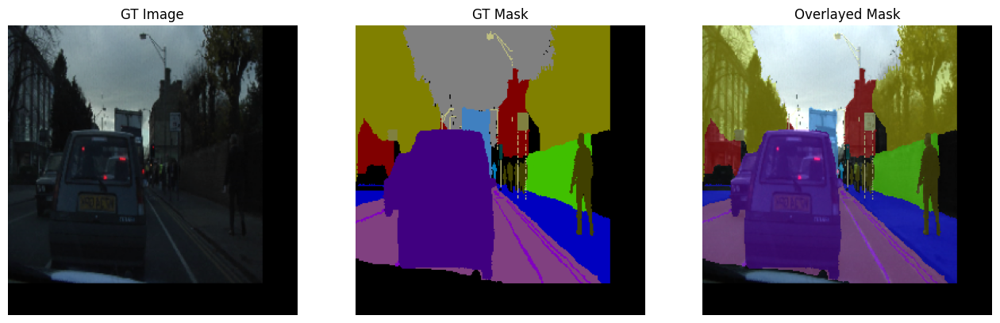

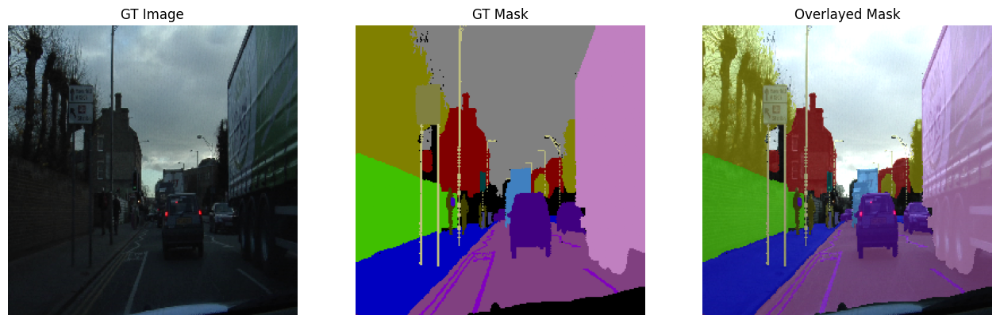

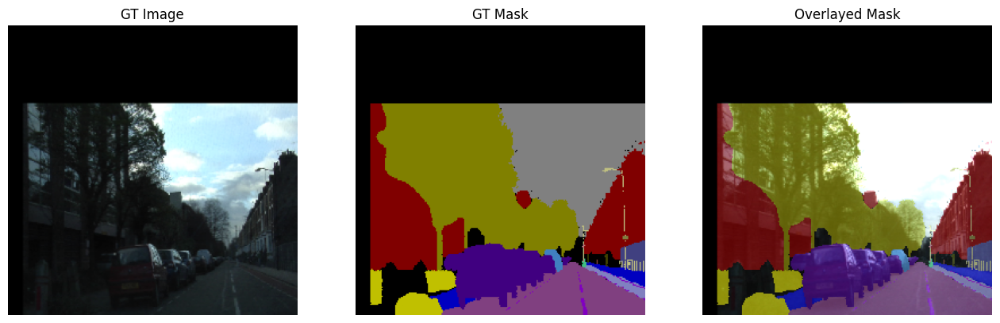

In [ ]:
for i, (images, masks) in enumerate(train_ds):
    if i == 3:
        break
    image, mask = images[0], masks[0]
    display_image_and_mask([image/255.0, mask], # Image and Mask in same pixel value range [0.0, 1.0] for display.
                           color_mask=True)

## 8 Custom Accuracy Metric

### 8.1 Mean IoU Metric

In [ ]:
def mean_iou(y_true, y_pred):
    """
    Arguments:
    y_true (ndarry or tensor): Ground truth mask. Shape: (batch_size, height, width)
                               Sparse representation of segmentation mask.

    y_pred (ndarray or tensor): Prediction from the model with or without softmax.
                                Shape: (batch_size, height, width, num_classes).

    return (scalar): Classwise mean IoU Metric.
    """
    # Get total number of classes from model output
    num_classes = y_pred.shape[-1]

    # Convert single channel (sparse) ground truth labels to one-hot encoding for metric computation.
    y_true = tf.one_hot(tf.cast(y_true, tf.int32), num_classes, axis=-1)

    # Convert multi-channel predicted output to one-hot encoded thresholded output for metric computation.
    y_pred = tf.one_hot(tf.math.argmax(y_pred, axis=-1), num_classes, axis=-1)

    # Axes corresponding to image width and height: [B, H, W C].
    axes = (1, 2)

    # Intersection: G ∩ P. Shape: (batch_size, num_classes)
    intersection = tf.math.reduce_sum(y_true * y_pred, axis=axes)

    # Cardinality Sum: |G| + |P|. Shape: (batch_size, num_classes)
    cardinality_sum = tf.math.reduce_sum(y_true, axis=axes) + tf.math.reduce_sum(y_pred, axis=axes)

    # Union: Shape: (batch_size, num_classes)
    union = cardinality_sum - intersection

    # Boolean (then converted to float) value for each class if it is present or not.
    is_class_present =  tf.cast(tf.math.not_equal(cardinality_sum, 0), dtype=tf.float32)

    # Sum along axis(1) to get number of classes in each image
    num_classes_present = tf.math.reduce_sum(is_class_present, axis=1)

    # Here, we use tf.math.divide_no_nan() to prevent division by 0 (i.e., 0/0 = 0).
    iou = tf.math.divide_no_nan(intersection, union)

    # IoU per image. Average over the total number of classes present in y_true and y_pred.
    # Shape: (batch_size,)
    iou = tf.math.reduce_sum(iou, axis=1) / num_classes_present

    # Compute the mean across the batch axis. Shape: Scalar
    mean_iou = tf.math.reduce_mean(iou)

    return mean_iou

## 9 Custom Loss Function


### 9.1 Dice / CCE  Loss

In [ ]:
def dice_coef_loss(y_true, y_pred):
    """
    Arguments:
    y_true (ndarray or tensor): Ground truth mask (G). Shape: (batch_size, height, width)
                                Sparse representation of segmentation mask.

    y_pred (ndarray or tensor): Softmax prediction (P) from the model.
                                Shape: (batch_size, height, width, num_classes).

    return (scalar): Loss
    """
    num_classes = y_pred.shape[-1]

    # Convert single channel ground truth labels to one-hot encoding for metric computation.
    y_true = tf.one_hot(tf.cast(y_true, tf.int32), num_classes, axis=-1)

    # Axes corresponding to image width and height: [B, H, W, C].
    axes = (1, 2)

    # Intersection: |G ∩ P|. Shape: (batch_size, num_classes)
    intersection = tf.math.reduce_sum(y_true * y_pred, axis=axes)

    # Total Sum: |G| + |P|. Shape: (batch_size, num_classes)
    total = tf.math.reduce_sum(y_true, axis=axes) + tf.math.reduce_sum(y_pred, axis=axes)

    # Dice coefficient. Shape: (batch_size, num_classes)
    eps = 1e-3
    dc = (2. *  intersection + eps) / (total + eps)

    # Compute the mean over the remaining axes (batch and classes).
    dc_mean = tf.math.reduce_mean(dc)

    # Compute cross-entropy loss.
    CCE =  tf.keras.losses.categorical_crossentropy(y_true, y_pred)

    return 1.0 - dc_mean + CCE

## 10 Compile and Train the Model

In [ ]:
model.compile(optimizer=Adam(learning_rate=TrainingConfig.LEARNING_RATE),
              loss=dice_coef_loss,
              metrics=['accuracy', mean_iou],
             )

In [ ]:
# Create a new checkpoint directory every time.
if not os.path.exists(TrainingConfig.CHECKPOINT_DIR):
    os.makedirs(TrainingConfig.CHECKPOINT_DIR)

num_versions = len(os.listdir(TrainingConfig.CHECKPOINT_DIR)) + 1
version_dir = TrainingConfig.CHECKPOINT_DIR +'/version_' + str(num_versions)
os.makedirs(version_dir)

# Callback to save the best model based on validation loss.
model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(filepath=f"{version_dir}.keras",
                                                               save_weights_only=False,
                                                               monitor='val_mean_iou',
                                                               mode='max',
                                                               save_best_only=True,
                                                              )

### Train the Model

In [ ]:
history = model.fit(train_ds,
                    epochs=TrainingConfig.EPOCHS,
                    verbose=1,
                    validation_data=valid_ds,
                    callbacks=[model_checkpoint_callback],
                   )

Epoch 1/101
46/46 [==============================] - ETA: 0s - loss: 2.3309 - accuracy: 0.6598 - mean_iou: 0.1612

46/46 [==============================] - 87s 1s/step - loss: 2.3309 - accuracy: 0.6598 - mean_iou: 0.1612 - val_loss: 3.0652 - val_accuracy: 0.6853 - val_mean_iou: 0.1766
Epoch 2/101
46/46 [==============================] - ETA: 0s - loss: 1.6173 - accuracy: 0.8017 - mean_iou: 0.2504

46/46 [==============================] - 77s 2s/step - loss: 1.6173 - accuracy: 0.8017 - mean_iou: 0.2504 - val_loss: 2.3776 - val_accuracy: 0.7742 - val_mean_iou: 0.2163
Epoch 3/101
46/46 [==============================] - ETA: 0s - loss: 1.4602 - accuracy: 0.8318 - mean_iou: 0.2784

46/46 [==============================] - 72s 2s/step - loss: 1.4602 - accuracy: 0.8318 - mean_iou: 0.2784 - val_loss: 1.8719 - val_accuracy: 0.8137 - val_mean_iou: 0.2502
Epoch 4/101
46/46 [==============================] - ETA: 0s - loss: 1.3570 - accuracy: 0.8511 - mean_iou: 0.3047

46/46 [==============================] - 73s 2s/step - loss: 1.3570 - accuracy: 0.8511 - mean_iou: 0.3047 - val_loss: 1.5924 - val_accuracy: 0.8376 - val_mean_iou: 0.2815
Epoch 5/101
46/46 [==============================] - ETA: 0s - loss: 1.2910 - accuracy: 0.8636 - mean_iou: 0.3232

46/46 [==============================] - 72s 2s/step - loss: 1.2910 - accuracy: 0.8636 - mean_iou: 0.3232 - val_loss: 1.4717 - val_accuracy: 0.8384 - val_mean_iou: 0.2908
Epoch 6/101
46/46 [==============================] - ETA: 0s - loss: 1.2365 - accuracy: 0.8742 - mean_iou: 0.3423

46/46 [==============================] - 79s 2s/step - loss: 1.2365 - accuracy: 0.8742 - mean_iou: 0.3423 - val_loss: 1.3566 - val_accuracy: 0.8556 - val_mean_iou: 0.3156
Epoch 7/101
46/46 [==============================] - ETA: 0s - loss: 1.1822 - accuracy: 0.8840 - mean_iou: 0.3620

46/46 [==============================] - 74s 2s/step - loss: 1.1822 - accuracy: 0.8840 - mean_iou: 0.3620 - val_loss: 1.3154 - val_accuracy: 0.8590 - val_mean_iou: 0.3263
Epoch 8/101
46/46 [==============================] - ETA: 0s - loss: 1.1485 - accuracy: 0.8904 - mean_iou: 0.3750

46/46 [==============================] - 72s 2s/step - loss: 1.1485 - accuracy: 0.8904 - mean_iou: 0.3750 - val_loss: 1.2943 - val_accuracy: 0.8580 - val_mean_iou: 0.3372
Epoch 9/101
46/46 [==============================] - ETA: 0s - loss: 1.1192 - accuracy: 0.8962 - mean_iou: 0.3922

46/46 [==============================] - 73s 2s/step - loss: 1.1192 - accuracy: 0.8962 - mean_iou: 0.3922 - val_loss: 1.2706 - val_accuracy: 0.8640 - val_mean_iou: 0.3455
Epoch 10/101
46/46 [==============================] - ETA: 0s - loss: 1.0922 - accuracy: 0.8999 - mean_iou: 0.4119

46/46 [==============================] - 73s 2s/step - loss: 1.0922 - accuracy: 0.8999 - mean_iou: 0.4119 - val_loss: 1.2546 - val_accuracy: 0.8646 - val_mean_iou: 0.3475
Epoch 11/101
46/46 [==============================] - ETA: 0s - loss: 1.0651 - accuracy: 0.9050 - mean_iou: 0.4263

46/46 [==============================] - 73s 2s/step - loss: 1.0651 - accuracy: 0.9050 - mean_iou: 0.4263 - val_loss: 1.2401 - val_accuracy: 0.8667 - val_mean_iou: 0.3539
Epoch 12/101
46/46 [==============================] - ETA: 0s - loss: 1.0526 - accuracy: 0.9067 - mean_iou: 0.4322

46/46 [==============================] - 78s 2s/step - loss: 1.0526 - accuracy: 0.9067 - mean_iou: 0.4322 - val_loss: 1.2276 - val_accuracy: 0.8698 - val_mean_iou: 0.3677
Epoch 13/101
46/46 [==============================] - ETA: 0s - loss: 1.0363 - accuracy: 0.9092 - mean_iou: 0.4435

46/46 [==============================] - 72s 2s/step - loss: 1.0363 - accuracy: 0.9092 - mean_iou: 0.4435 - val_loss: 1.2264 - val_accuracy: 0.8695 - val_mean_iou: 0.3710
Epoch 14/101
46/46 [==============================] - ETA: 0s - loss: 1.0213 - accuracy: 0.9114 - mean_iou: 0.4514

46/46 [==============================] - 77s 2s/step - loss: 1.0213 - accuracy: 0.9114 - mean_iou: 0.4514 - val_loss: 1.2077 - val_accuracy: 0.8708 - val_mean_iou: 0.3792
Epoch 15/101
46/46 [==============================] - ETA: 0s - loss: 1.0054 - accuracy: 0.9140 - mean_iou: 0.4636

46/46 [==============================] - 77s 2s/step - loss: 1.0054 - accuracy: 0.9140 - mean_iou: 0.4636 - val_loss: 1.2094 - val_accuracy: 0.8718 - val_mean_iou: 0.3838
Epoch 16/101
46/46 [==============================] - ETA: 0s - loss: 0.9930 - accuracy: 0.9163 - mean_iou: 0.4742

46/46 [==============================] - 77s 2s/step - loss: 0.9930 - accuracy: 0.9163 - mean_iou: 0.4742 - val_loss: 1.2066 - val_accuracy: 0.8706 - val_mean_iou: 0.3845
Epoch 17/101
46/46 [==============================] - ETA: 0s - loss: 0.9804 - accuracy: 0.9179 - mean_iou: 0.4785

46/46 [==============================] - 73s 2s/step - loss: 0.9804 - accuracy: 0.9179 - mean_iou: 0.4785 - val_loss: 1.1975 - val_accuracy: 0.8744 - val_mean_iou: 0.3896
Epoch 18/101
46/46 [==============================] - ETA: 0s - loss: 0.9713 - accuracy: 0.9187 - mean_iou: 0.4857

46/46 [==============================] - 74s 2s/step - loss: 0.9713 - accuracy: 0.9187 - mean_iou: 0.4857 - val_loss: 1.1972 - val_accuracy: 0.8710 - val_mean_iou: 0.3952
Epoch 19/101
46/46 [==============================] - 55s 1s/step - loss: 0.9697 - accuracy: 0.9184 - mean_iou: 0.4935 - val_loss: 1.1834 - val_accuracy: 0.8734 - val_mean_iou: 0.3842
Epoch 20/101
46/46 [==============================] - ETA: 0s - loss: 0.9541 - accuracy: 0.9215 - mean_iou: 0.5031

46/46 [==============================] - 77s 2s/step - loss: 0.9541 - accuracy: 0.9215 - mean_iou: 0.5031 - val_loss: 1.1875 - val_accuracy: 0.8731 - val_mean_iou: 0.4009
Epoch 21/101
46/46 [==============================] - 56s 1s/step - loss: 0.9460 - accuracy: 0.9231 - mean_iou: 0.5038 - val_loss: 1.1869 - val_accuracy: 0.8754 - val_mean_iou: 0.3983
Epoch 22/101
46/46 [==============================] - ETA: 0s - loss: 0.9448 - accuracy: 0.9226 - mean_iou: 0.5068

46/46 [==============================] - 73s 2s/step - loss: 0.9448 - accuracy: 0.9226 - mean_iou: 0.5068 - val_loss: 1.1795 - val_accuracy: 0.8757 - val_mean_iou: 0.4043
Epoch 23/101
46/46 [==============================] - ETA: 0s - loss: 0.9338 - accuracy: 0.9241 - mean_iou: 0.5179

46/46 [==============================] - 77s 2s/step - loss: 0.9338 - accuracy: 0.9241 - mean_iou: 0.5179 - val_loss: 1.1660 - val_accuracy: 0.8774 - val_mean_iou: 0.4045
Epoch 24/101
46/46 [==============================] - ETA: 0s - loss: 0.9279 - accuracy: 0.9248 - mean_iou: 0.5210

46/46 [==============================] - 77s 2s/step - loss: 0.9279 - accuracy: 0.9248 - mean_iou: 0.5210 - val_loss: 1.1718 - val_accuracy: 0.8773 - val_mean_iou: 0.4050
Epoch 25/101
46/46 [==============================] - 51s 1s/step - loss: 0.9234 - accuracy: 0.9252 - mean_iou: 0.5264 - val_loss: 1.1558 - val_accuracy: 0.8779 - val_mean_iou: 0.4018
Epoch 26/101
46/46 [==============================] - 55s 1s/step - loss: 0.9200 - accuracy: 0.9254 - mean_iou: 0.5260 - val_loss: 1.1662 - val_accuracy: 0.8756 - val_mean_iou: 0.4012
Epoch 27/101
46/46 [==============================] - ETA: 0s - loss: 0.9144 - accuracy: 0.9264 - mean_iou: 0.5309

46/46 [==============================] - 73s 2s/step - loss: 0.9144 - accuracy: 0.9264 - mean_iou: 0.5309 - val_loss: 1.1715 - val_accuracy: 0.8780 - val_mean_iou: 0.4137
Epoch 28/101
46/46 [==============================] - ETA: 0s - loss: 0.9051 - accuracy: 0.9288 - mean_iou: 0.5362

46/46 [==============================] - 76s 2s/step - loss: 0.9051 - accuracy: 0.9288 - mean_iou: 0.5362 - val_loss: 1.1450 - val_accuracy: 0.8823 - val_mean_iou: 0.4190
Epoch 29/101
46/46 [==============================] - 55s 1s/step - loss: 0.9001 - accuracy: 0.9291 - mean_iou: 0.5403 - val_loss: 1.1489 - val_accuracy: 0.8817 - val_mean_iou: 0.4143
Epoch 30/101
46/46 [==============================] - ETA: 0s - loss: 0.8925 - accuracy: 0.9304 - mean_iou: 0.5443

46/46 [==============================] - 76s 2s/step - loss: 0.8925 - accuracy: 0.9304 - mean_iou: 0.5443 - val_loss: 1.1421 - val_accuracy: 0.8829 - val_mean_iou: 0.4227
Epoch 31/101
46/46 [==============================] - 55s 1s/step - loss: 0.8919 - accuracy: 0.9302 - mean_iou: 0.5485 - val_loss: 1.1440 - val_accuracy: 0.8840 - val_mean_iou: 0.4210
Epoch 32/101
46/46 [==============================] - 54s 1s/step - loss: 0.8869 - accuracy: 0.9305 - mean_iou: 0.5550 - val_loss: 1.1754 - val_accuracy: 0.8787 - val_mean_iou: 0.4119
Epoch 33/101
46/46 [==============================] - 56s 1s/step - loss: 0.8888 - accuracy: 0.9304 - mean_iou: 0.5494 - val_loss: 1.1512 - val_accuracy: 0.8802 - val_mean_iou: 0.4153
Epoch 34/101
46/46 [==============================] - 57s 1s/step - loss: 0.8805 - accuracy: 0.9322 - mean_iou: 0.5542 - val_loss: 1.1517 - val_accuracy: 0.8804 - val_mean_iou: 0.4144
Epoch 35/101
46/46 [==============================] - ETA: 0s - loss: 0.8735 - accuracy: 0.93

46/46 [==============================] - 77s 2s/step - loss: 0.8735 - accuracy: 0.9330 - mean_iou: 0.5651 - val_loss: 1.1315 - val_accuracy: 0.8846 - val_mean_iou: 0.4250
Epoch 36/101
46/46 [==============================] - ETA: 0s - loss: 0.8747 - accuracy: 0.9324 - mean_iou: 0.5622

46/46 [==============================] - 77s 2s/step - loss: 0.8747 - accuracy: 0.9324 - mean_iou: 0.5622 - val_loss: 1.1528 - val_accuracy: 0.8806 - val_mean_iou: 0.4279
Epoch 37/101
46/46 [==============================] - 57s 1s/step - loss: 0.8779 - accuracy: 0.9317 - mean_iou: 0.5590 - val_loss: 1.1656 - val_accuracy: 0.8816 - val_mean_iou: 0.4258
Epoch 38/101
46/46 [==============================] - 52s 1s/step - loss: 0.8711 - accuracy: 0.9331 - mean_iou: 0.5612 - val_loss: 1.1427 - val_accuracy: 0.8833 - val_mean_iou: 0.4221
Epoch 39/101
46/46 [==============================] - 55s 1s/step - loss: 0.8622 - accuracy: 0.9342 - mean_iou: 0.5717 - val_loss: 1.1552 - val_accuracy: 0.8811 - val_mean_iou: 0.4244
Epoch 40/101
46/46 [==============================] - 51s 1s/step - loss: 0.8593 - accuracy: 0.9350 - mean_iou: 0.5760 - val_loss: 1.1376 - val_accuracy: 0.8831 - val_mean_iou: 0.4254
Epoch 41/101
46/46 [==============================] - 55s 1s/step - loss: 0.8592 - accuracy: 

46/46 [==============================] - 72s 2s/step - loss: 0.8465 - accuracy: 0.9367 - mean_iou: 0.5852 - val_loss: 1.1491 - val_accuracy: 0.8821 - val_mean_iou: 0.4327
Epoch 46/101
46/46 [==============================] - 51s 1s/step - loss: 0.8476 - accuracy: 0.9354 - mean_iou: 0.5880 - val_loss: 1.1499 - val_accuracy: 0.8832 - val_mean_iou: 0.4279
Epoch 47/101
46/46 [==============================] - 55s 1s/step - loss: 0.8439 - accuracy: 0.9367 - mean_iou: 0.5902 - val_loss: 1.1467 - val_accuracy: 0.8838 - val_mean_iou: 0.4316
Epoch 48/101
46/46 [==============================] - 56s 1s/step - loss: 0.8399 - accuracy: 0.9375 - mean_iou: 0.5900 - val_loss: 1.1291 - val_accuracy: 0.8847 - val_mean_iou: 0.4319
Epoch 49/101
46/46 [==============================] - 55s 1s/step - loss: 0.8383 - accuracy: 0.9374 - mean_iou: 0.5895 - val_loss: 1.1367 - val_accuracy: 0.8847 - val_mean_iou: 0.4314
Epoch 50/101
46/46 [==============================] - 55s 1s/step - loss: 0.8405 - accuracy: 

46/46 [==============================] - 73s 2s/step - loss: 0.8359 - accuracy: 0.9378 - mean_iou: 0.5953 - val_loss: 1.1283 - val_accuracy: 0.8831 - val_mean_iou: 0.4377
Epoch 52/101
46/46 [==============================] - 55s 1s/step - loss: 0.8309 - accuracy: 0.9385 - mean_iou: 0.6006 - val_loss: 1.1397 - val_accuracy: 0.8844 - val_mean_iou: 0.4265
Epoch 53/101
46/46 [==============================] - 55s 1s/step - loss: 0.8313 - accuracy: 0.9386 - mean_iou: 0.5981 - val_loss: 1.1344 - val_accuracy: 0.8841 - val_mean_iou: 0.4321
Epoch 54/101
46/46 [==============================] - 55s 1s/step - loss: 0.8303 - accuracy: 0.9381 - mean_iou: 0.6035 - val_loss: 1.1306 - val_accuracy: 0.8859 - val_mean_iou: 0.4350
Epoch 55/101
46/46 [==============================] - 56s 1s/step - loss: 0.8264 - accuracy: 0.9393 - mean_iou: 0.5998 - val_loss: 1.1527 - val_accuracy: 0.8838 - val_mean_iou: 0.4338
Epoch 56/101
46/46 [==============================] - 55s 1s/step - loss: 0.8301 - accuracy: 

46/46 [==============================] - 76s 2s/step - loss: 0.8269 - accuracy: 0.9383 - mean_iou: 0.6054 - val_loss: 1.1411 - val_accuracy: 0.8847 - val_mean_iou: 0.4415
Epoch 58/101
46/46 [==============================] - 51s 1s/step - loss: 0.8229 - accuracy: 0.9394 - mean_iou: 0.6067 - val_loss: 1.1361 - val_accuracy: 0.8842 - val_mean_iou: 0.4328
Epoch 59/101
46/46 [==============================] - 51s 1s/step - loss: 0.8216 - accuracy: 0.9396 - mean_iou: 0.6074 - val_loss: 1.1436 - val_accuracy: 0.8863 - val_mean_iou: 0.4222
Epoch 60/101
46/46 [==============================] - 51s 1s/step - loss: 0.8209 - accuracy: 0.9398 - mean_iou: 0.6121 - val_loss: 1.1251 - val_accuracy: 0.8877 - val_mean_iou: 0.4385
Epoch 61/101
46/46 [==============================] - 50s 1s/step - loss: 0.8165 - accuracy: 0.9408 - mean_iou: 0.6106 - val_loss: 1.1517 - val_accuracy: 0.8814 - val_mean_iou: 0.4369
Epoch 62/101
46/46 [==============================] - 55s 1s/step - loss: 0.8125 - accuracy: 

46/46 [==============================] - 73s 2s/step - loss: 0.8105 - accuracy: 0.9414 - mean_iou: 0.6151 - val_loss: 1.1350 - val_accuracy: 0.8854 - val_mean_iou: 0.4435
Epoch 65/101
46/46 [==============================] - ETA: 0s - loss: 0.8111 - accuracy: 0.9411 - mean_iou: 0.6186

46/46 [==============================] - 72s 2s/step - loss: 0.8111 - accuracy: 0.9411 - mean_iou: 0.6186 - val_loss: 1.1259 - val_accuracy: 0.8852 - val_mean_iou: 0.4476
Epoch 66/101
46/46 [==============================] - 51s 1s/step - loss: 0.8087 - accuracy: 0.9409 - mean_iou: 0.6175 - val_loss: 1.1181 - val_accuracy: 0.8885 - val_mean_iou: 0.4432
Epoch 67/101
46/46 [==============================] - 57s 1s/step - loss: 0.8029 - accuracy: 0.9416 - mean_iou: 0.6225 - val_loss: 1.1279 - val_accuracy: 0.8873 - val_mean_iou: 0.4336
Epoch 68/101
46/46 [==============================] - 52s 1s/step - loss: 0.7821 - accuracy: 0.9415 - mean_iou: 0.6213 - val_loss: 1.0941 - val_accuracy: 0.8879 - val_mean_iou: 0.4372
Epoch 69/101
46/46 [==============================] - 51s 1s/step - loss: 0.7545 - accuracy: 0.9411 - mean_iou: 0.6222 - val_loss: 1.0949 - val_accuracy: 0.8884 - val_mean_iou: 0.4383
Epoch 70/101
46/46 [==============================] - 57s 1s/step - loss: 0.7469 - accuracy: 

46/46 [==============================] - 76s 2s/step - loss: 0.7353 - accuracy: 0.9427 - mean_iou: 0.6306 - val_loss: 1.0877 - val_accuracy: 0.8864 - val_mean_iou: 0.4505
Epoch 76/101
46/46 [==============================] - ETA: 0s - loss: 0.7225 - accuracy: 0.9422 - mean_iou: 0.6266

46/46 [==============================] - 73s 2s/step - loss: 0.7225 - accuracy: 0.9422 - mean_iou: 0.6266 - val_loss: 1.0460 - val_accuracy: 0.8906 - val_mean_iou: 0.4575
Epoch 77/101
46/46 [==============================] - 51s 1s/step - loss: 0.7077 - accuracy: 0.9424 - mean_iou: 0.6312 - val_loss: 1.0495 - val_accuracy: 0.8896 - val_mean_iou: 0.4494
Epoch 78/101
46/46 [==============================] - 55s 1s/step - loss: 0.6930 - accuracy: 0.9428 - mean_iou: 0.6281 - val_loss: 1.0395 - val_accuracy: 0.8886 - val_mean_iou: 0.4478
Epoch 79/101
46/46 [==============================] - 51s 1s/step - loss: 0.6599 - accuracy: 0.9420 - mean_iou: 0.6315 - val_loss: 1.0231 - val_accuracy: 0.8876 - val_mean_iou: 0.4376
Epoch 80/101
46/46 [==============================] - 50s 1s/step - loss: 0.6518 - accuracy: 0.9412 - mean_iou: 0.6255 - val_loss: 1.0201 - val_accuracy: 0.8871 - val_mean_iou: 0.4459
Epoch 81/101
46/46 [==============================] - 51s 1s/step - loss: 0.6251 - accuracy: 

46/46 [==============================] - 72s 2s/step - loss: 0.5165 - accuracy: 0.9418 - mean_iou: 0.6324 - val_loss: 0.9151 - val_accuracy: 0.8897 - val_mean_iou: 0.4629
Epoch 97/101
46/46 [==============================] - 51s 1s/step - loss: 0.4905 - accuracy: 0.9439 - mean_iou: 0.6410 - val_loss: 0.9084 - val_accuracy: 0.8876 - val_mean_iou: 0.4570
Epoch 98/101
46/46 [==============================] - 52s 1s/step - loss: 0.4836 - accuracy: 0.9442 - mean_iou: 0.6404 - val_loss: 0.9267 - val_accuracy: 0.8884 - val_mean_iou: 0.4531
Epoch 99/101
46/46 [==============================] - 55s 1s/step - loss: 0.4796 - accuracy: 0.9441 - mean_iou: 0.6437 - val_loss: 0.9206 - val_accuracy: 0.8899 - val_mean_iou: 0.4588
Epoch 100/101
46/46 [==============================] - 55s 1s/step - loss: 0.4770 - accuracy: 0.9446 - mean_iou: 0.6475 - val_loss: 0.9291 - val_accuracy: 0.8855 - val_mean_iou: 0.4585
Epoch 101/101
46/46 [==============================] - 50s 1s/step - loss: 0.4791 - accuracy

## 11 Plot the Training Results

In [ ]:
def plot_results(metrics, ylabel=None, ylim=None, metric_name=None, color=None):

    fig, ax = plt.subplots(figsize=(18, 5))

    if not (isinstance(metric_name, list) or isinstance(metric_name, tuple)):
        metrics = [metrics,]
        metric_name = [metric_name,]

    for idx, metric in enumerate(metrics):
        ax.plot(metric, color=color[idx])

    plt.xlabel("Epoch")
    plt.ylabel(ylabel)
    plt.title(ylabel)
    plt.xlim([0, TrainingConfig.EPOCHS-1])
    plt.ylim(ylim)
    # Tailor x-axis tick marks
    ax.xaxis.set_major_locator(MultipleLocator(5))
    ax.xaxis.set_major_formatter(FormatStrFormatter('%d'))
    ax.xaxis.set_minor_locator(MultipleLocator(1))
    plt.grid(True)
    plt.legend(metric_name)
    plt.show(block=block_plot)
    plt.close()

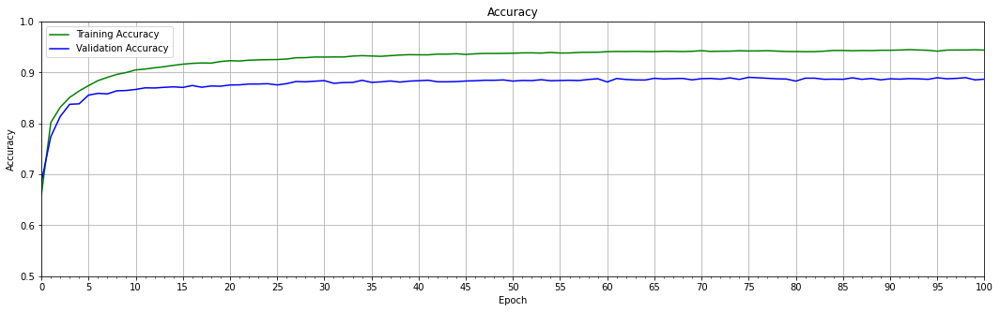

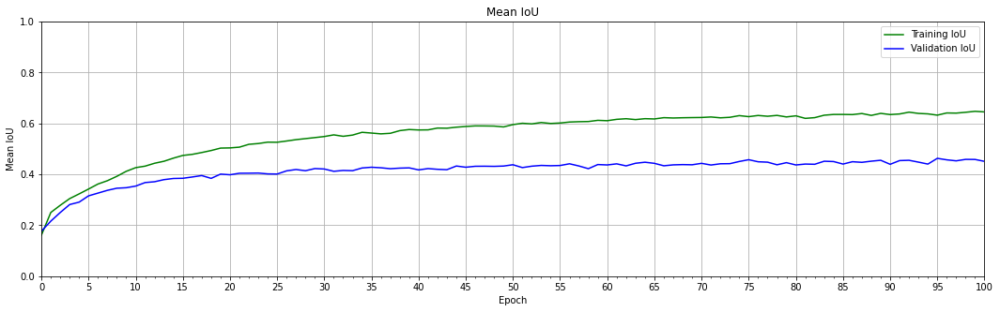

In [ ]:
# Pixel accuracy.
train_acc = history.history["accuracy"]
valid_acc = history.history["val_accuracy"]

# Mean IoU.
train_iou = history.history["mean_iou"]
valid_iou = history.history["val_mean_iou"]


plot_results([ train_acc, valid_acc ],
            ylabel="Accuracy",
            ylim = [0.5, 1.0],
            metric_name=["Training Accuracy", "Validation Accuracy"],
            color=["g", "b"])

plot_results([ train_iou, valid_iou ],
            ylabel="Mean IoU",
            ylim = [0.0, 1.0],
            metric_name=["Training IoU", "Validation IoU"],
            color=["g", "b"])

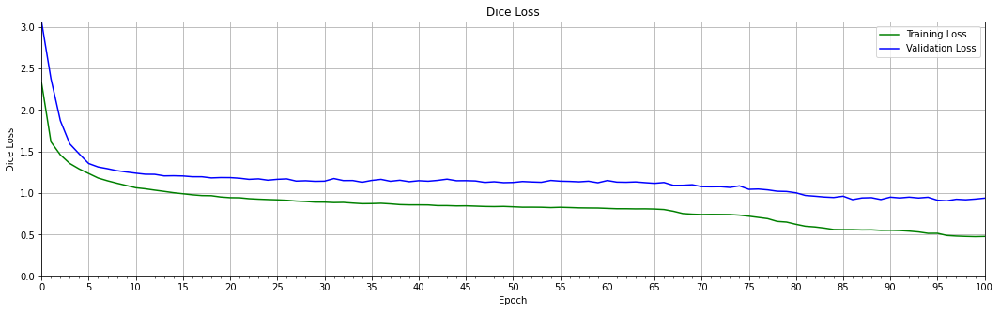

In [ ]:
train_loss = history.history["loss"]
valid_loss = history.history["val_loss"]


max_loss = max(max(train_loss), max(valid_loss))

plot_results([ train_loss, valid_loss ],
            ylabel="Dice Loss",
            ylim = [0.0, max_loss],
            metric_name=["Training Loss", "Validation Loss"],
            color=["g", "b"]);

## 12 Perform Inference


In [ ]:
trained_model = tf.keras.models.load_model(f"{version_dir}.keras", custom_objects={'mean_iou':mean_iou,
                                                                        'dice_coef_loss':dice_coef_loss})

In [ ]:
evaluate = trained_model.evaluate(valid_ds)

print(f"Model evaluation accuracy:  {evaluate[1]*100.:.3f}")
print(f"Model evaluation mean IoU:  {evaluate[2]*100.:.3f}")

12/12 [==============================] - 11s 842ms/step - loss: 0.9151 - accuracy: 0.8897 - mean_iou: 0.4629
Model evaluation accuracy:  88.972
Model evaluation mean IoU:  46.287


### Inference

In [ ]:
def inference(model, dataset):

    num_batches_to_process = InferenceConfig.NUM_BATCHES

    for idx, data in enumerate(dataset):

        batch_img, batch_mask = data[0], data[1]
        pred_all = (model.predict(batch_img)).astype('float32')
        pred_all = pred_all.argmax(-1)
        batch_img = (batch_img).astype('uint8')
        if idx == num_batches_to_process:
            break

        for i in range(0, len(batch_img)):

            fig = plt.figure(figsize=(20,8))

            # Display the original image.
            ax1 = fig.add_subplot(1,4,1)
            ax1.imshow(batch_img[i])
            ax1.title.set_text('Actual frame')
            plt.axis('off')

            # Display the ground truth mask.
            true_mask_rgb = num_to_rgb(batch_mask[i], color_map=id2color)
            ax2 = fig.add_subplot(1,4,2)
            ax2.set_title('Ground truth labels')
            ax2.imshow(true_mask_rgb)
            plt.axis('off')

            # Display the predicted segmentation mask.
            pred_mask_rgb = num_to_rgb(pred_all[i], color_map=id2color)
            ax3 = fig.add_subplot(1,4,3)
            ax3.set_title('Predicted labels')
            ax3.imshow(pred_mask_rgb)
            plt.axis('off')

            # Display the predicted segmentation mask overlayed on the original image.
            overlayed_image = image_overlay(batch_img[i], np.array((pred_mask_rgb* 255).astype('uint8')))
            ax4 = fig.add_subplot(1,4,4)
            ax4.set_title('Overlayed image')
            ax4.imshow(overlayed_image)
            plt.axis('off')

            plt.show()

1/1 [==============================] - 1s 977ms/step


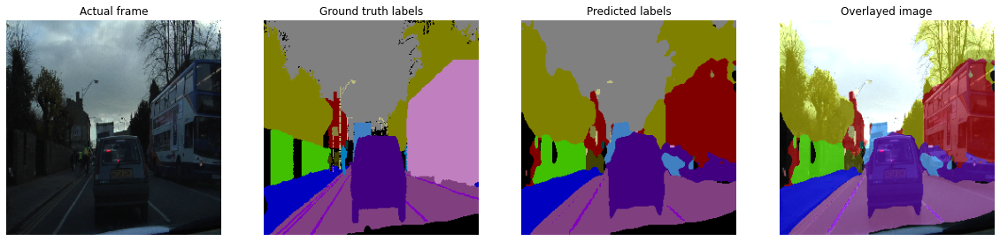

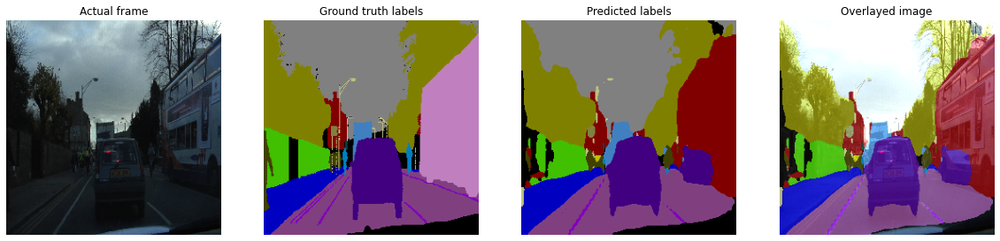

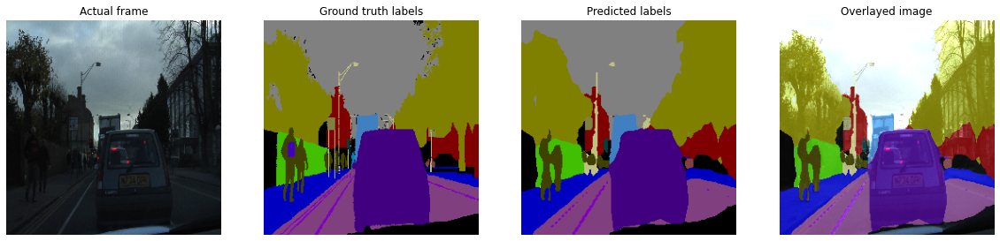

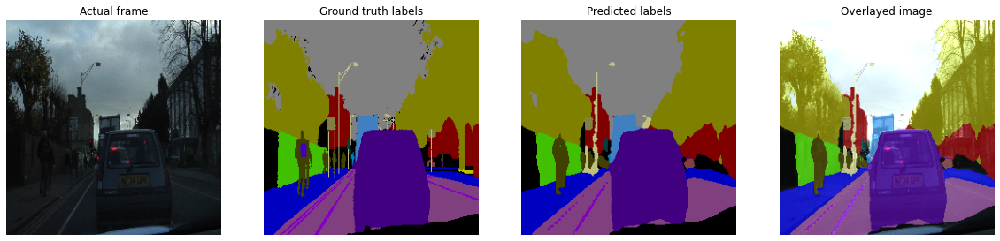

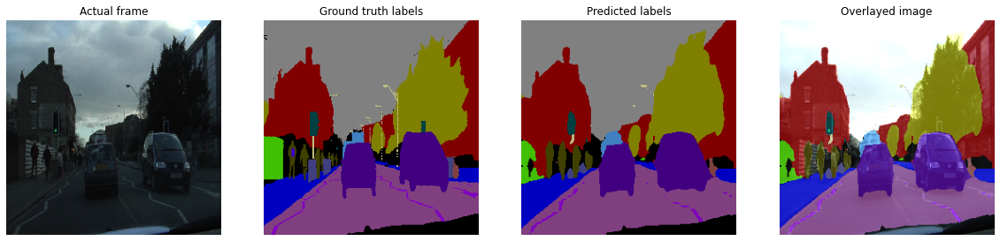

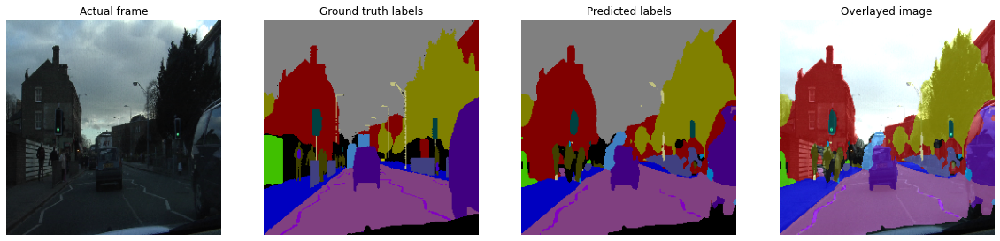

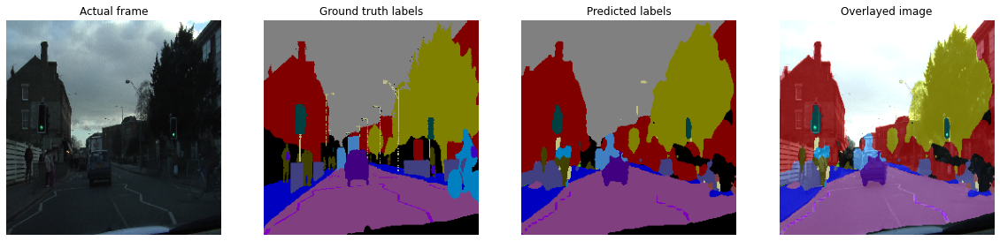

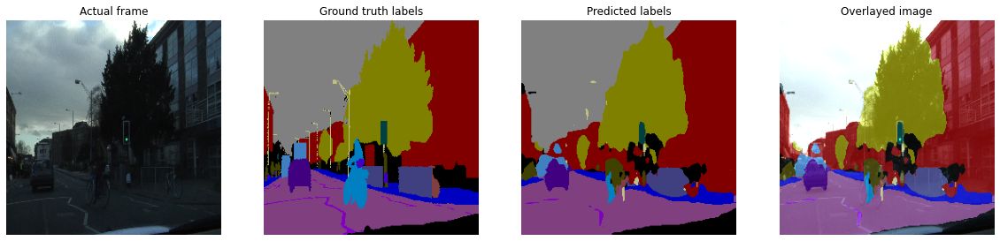

1/1 [==============================] - 0s 33ms/step


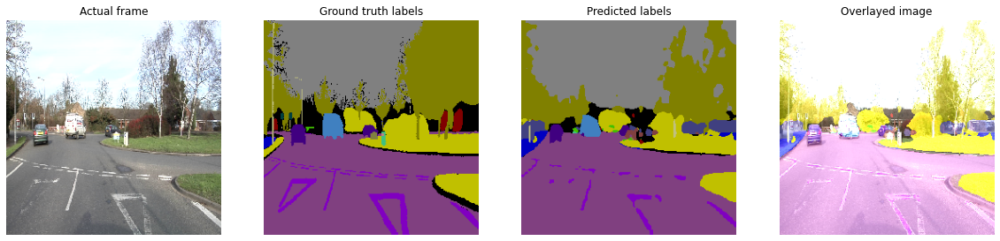

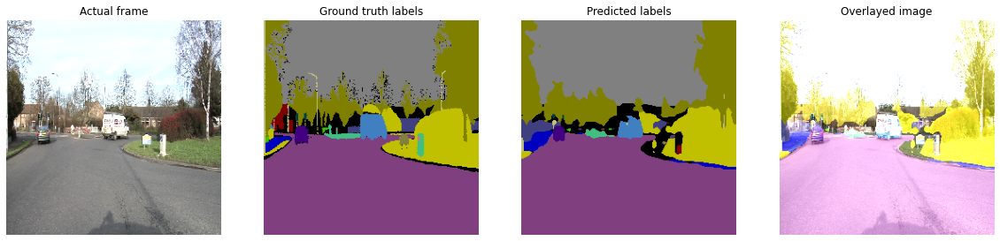

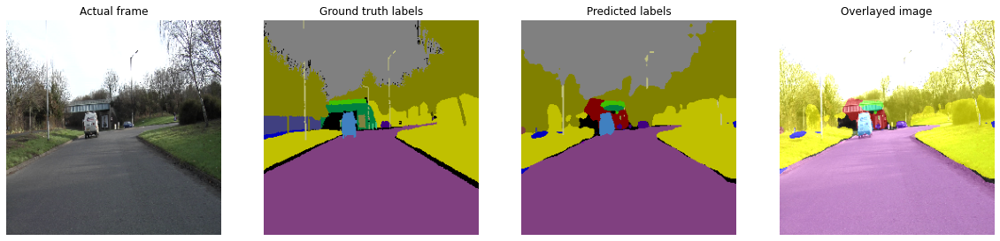

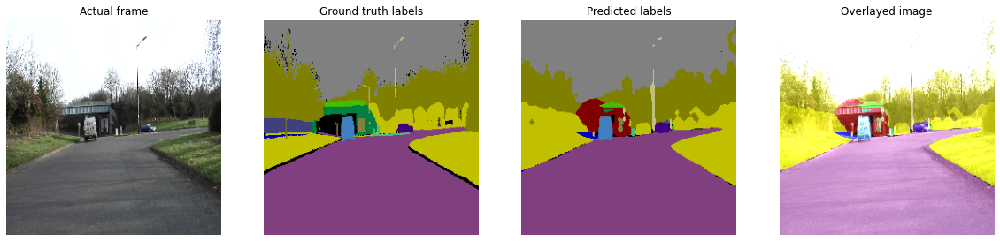

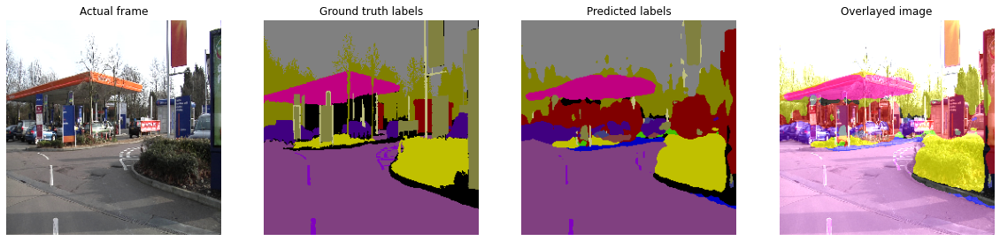

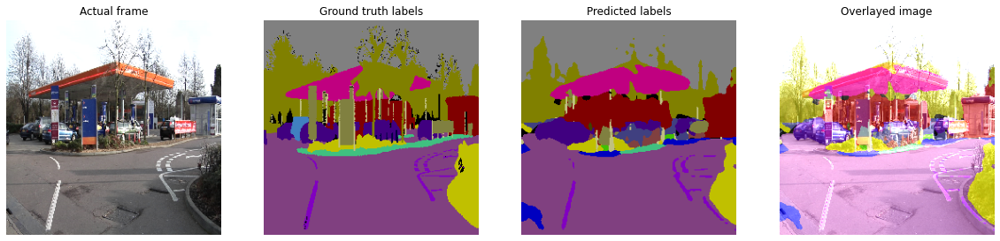

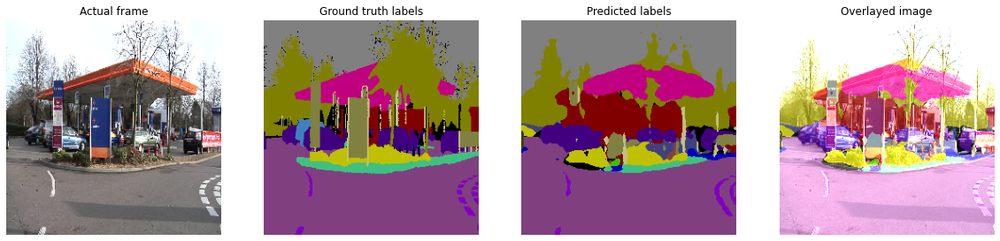

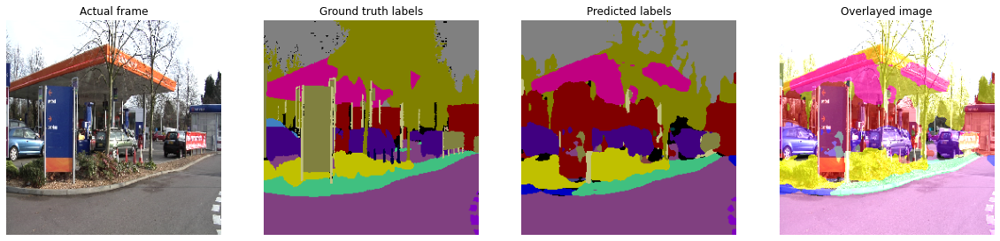

1/1 [==============================] - 0s 32ms/step


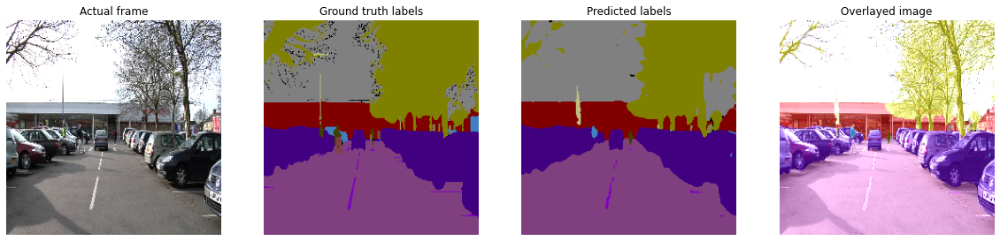

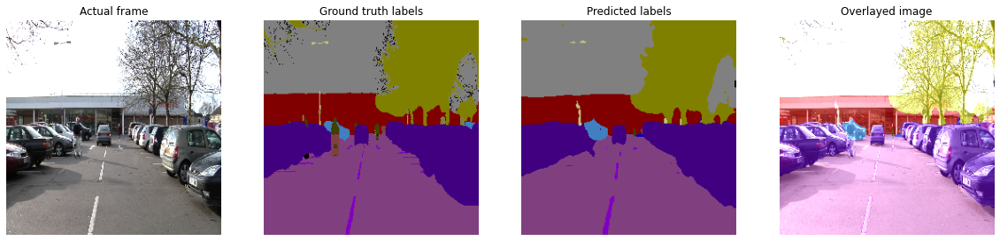

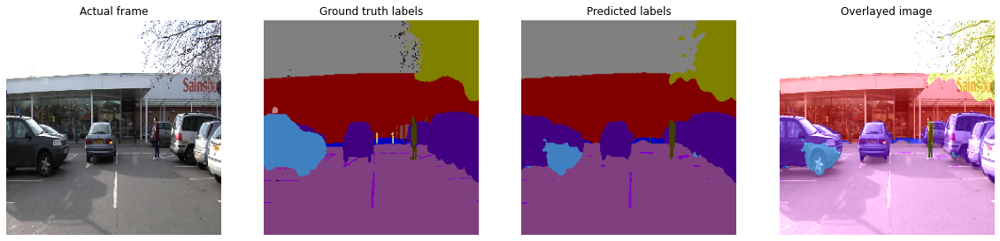

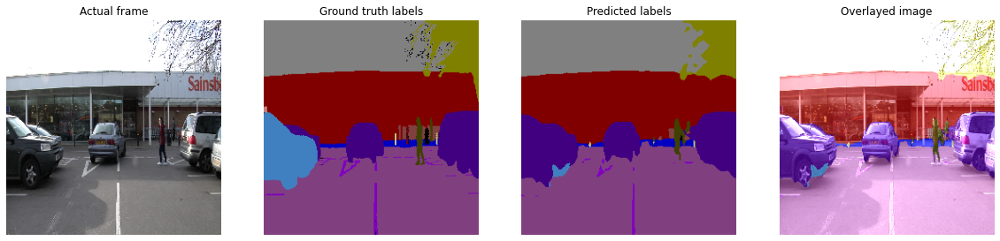

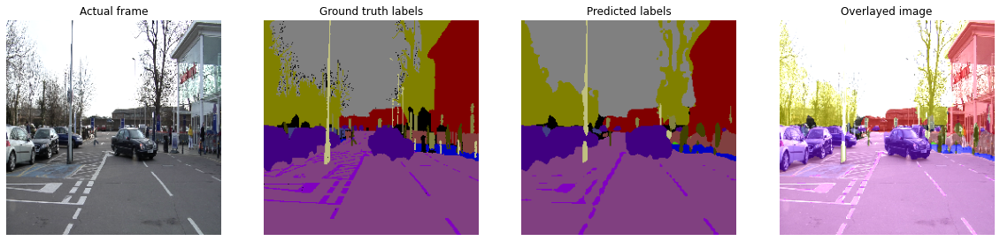

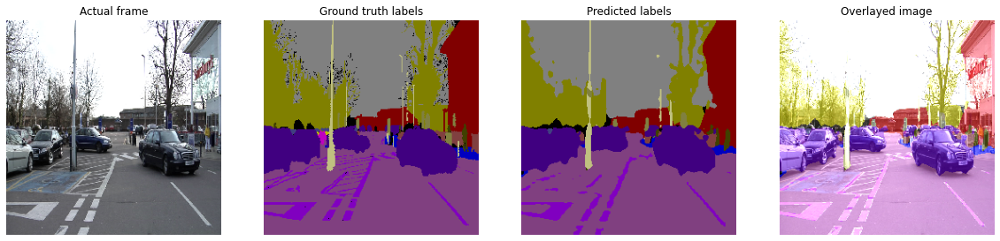

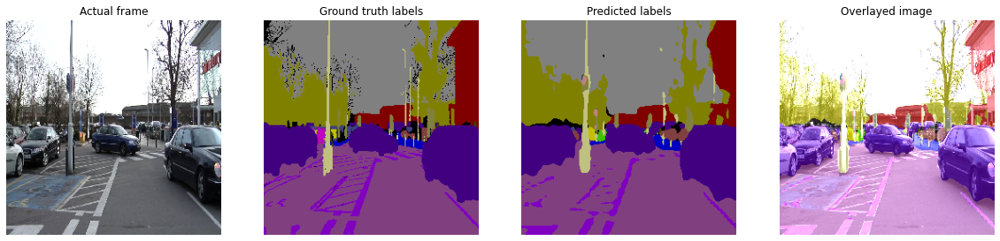

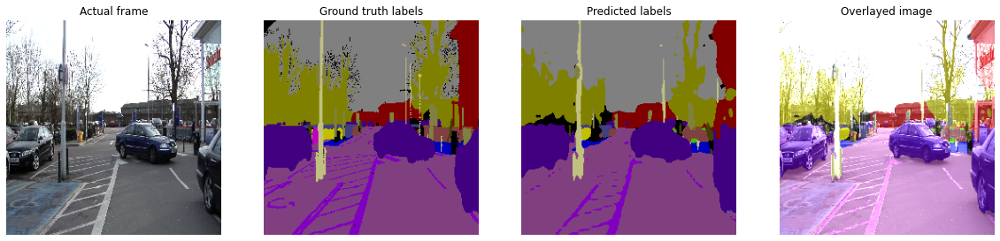

1/1 [==============================] - 0s 30ms/step


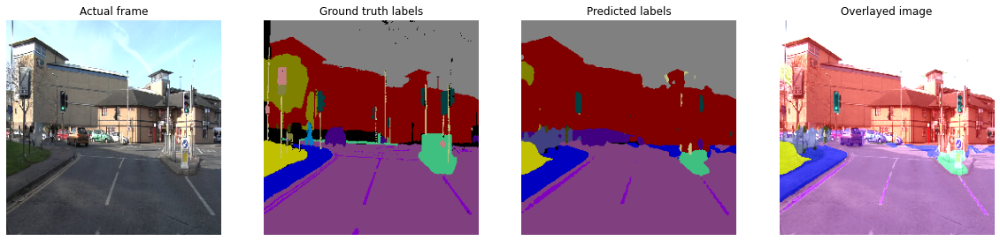

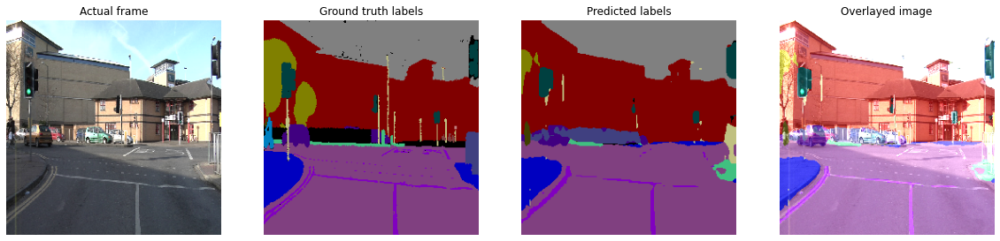

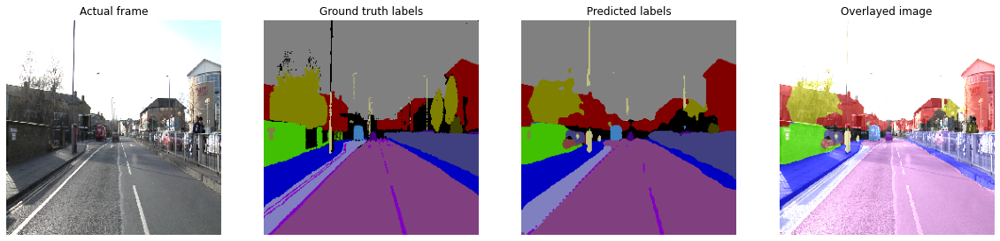

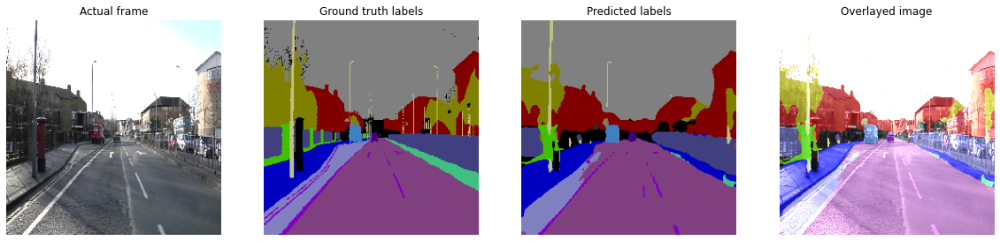

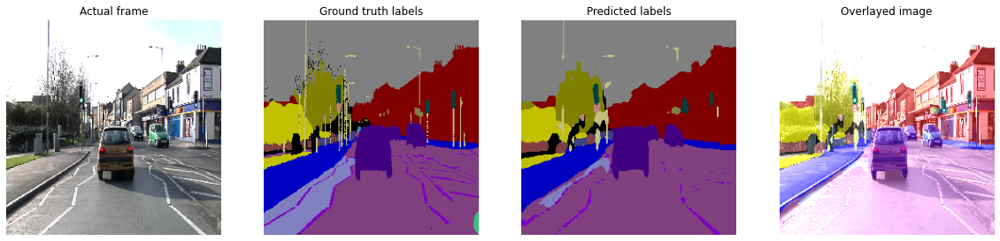

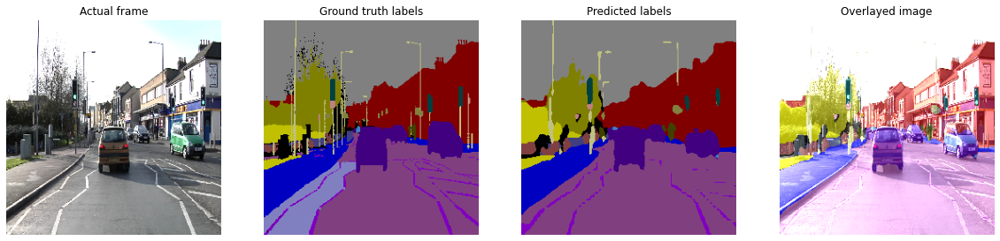

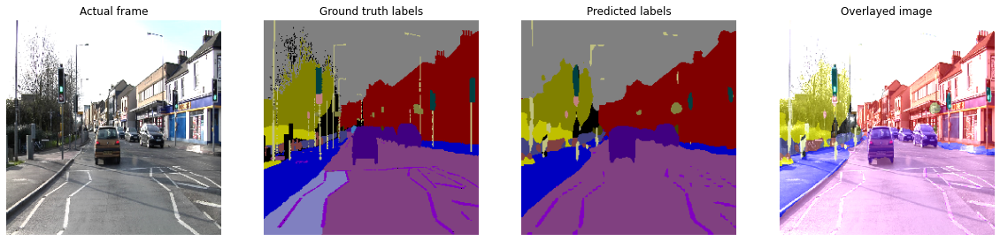

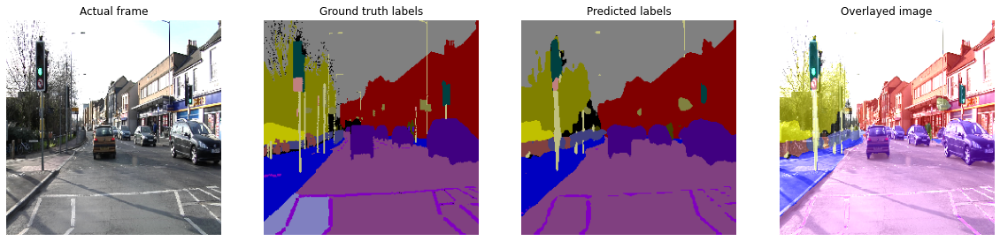

1/1 [==============================] - 0s 40ms/step


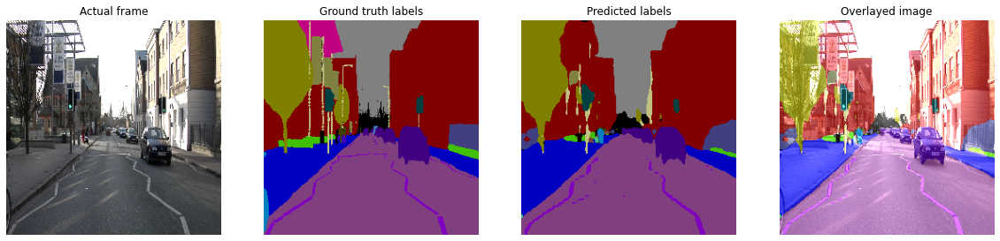

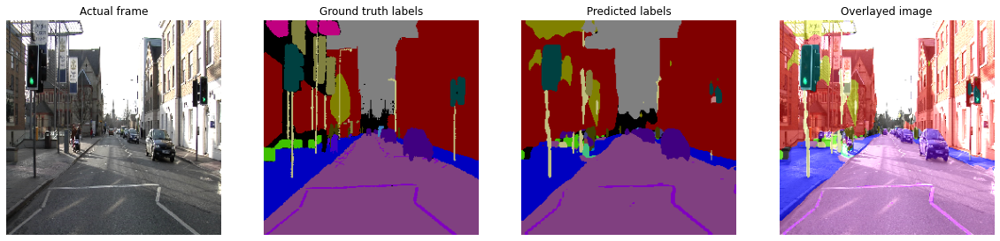

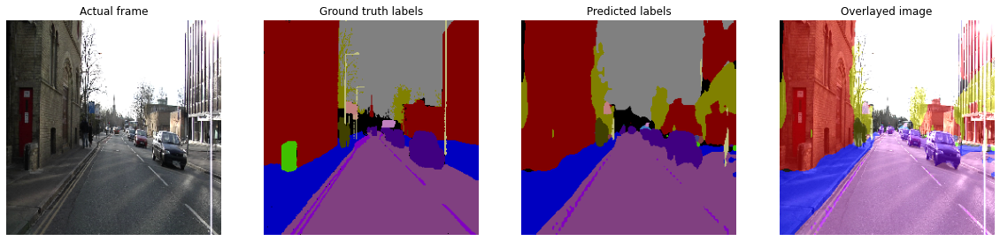

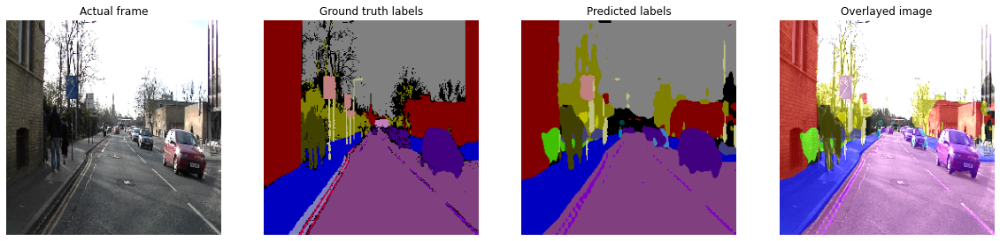

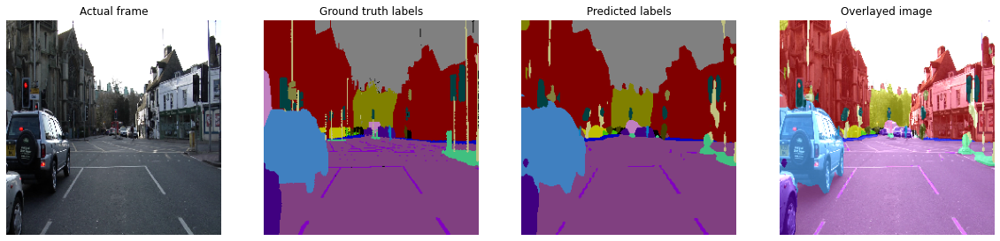

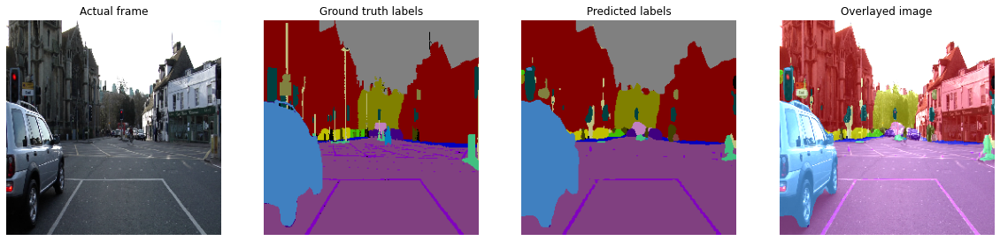

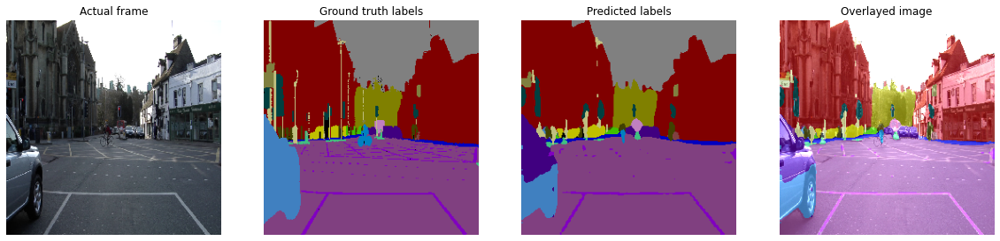

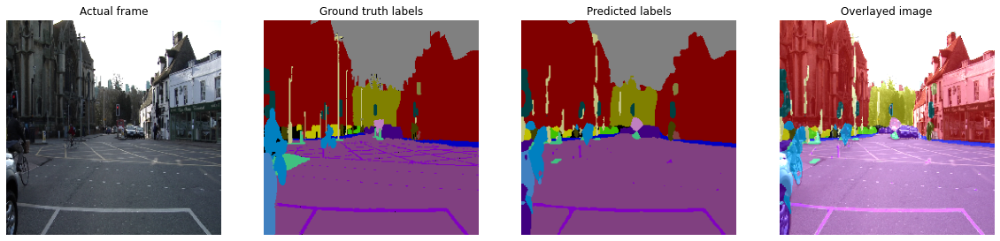

1/1 [==============================] - 0s 29ms/step


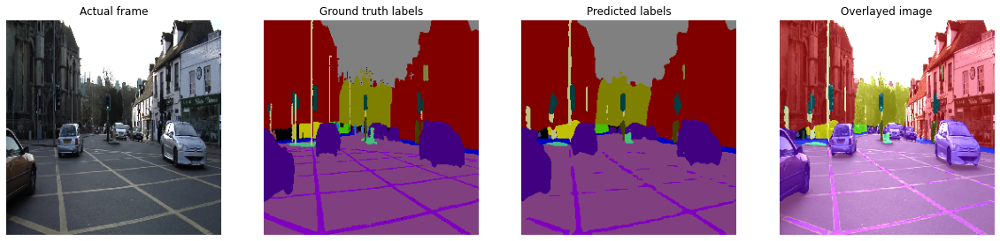

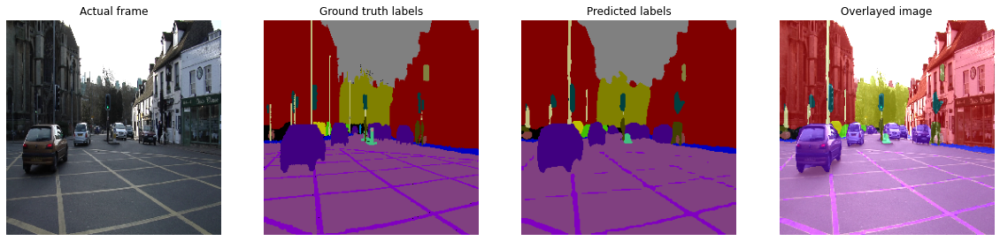

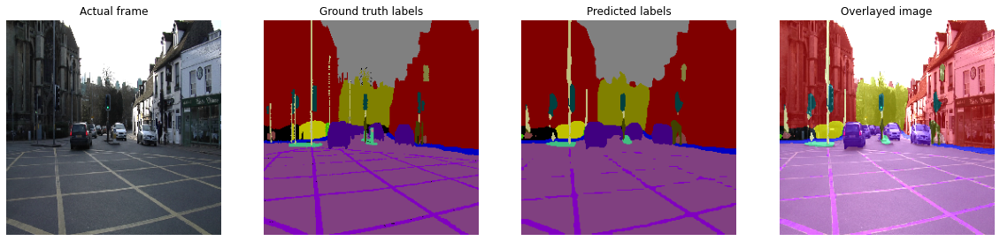

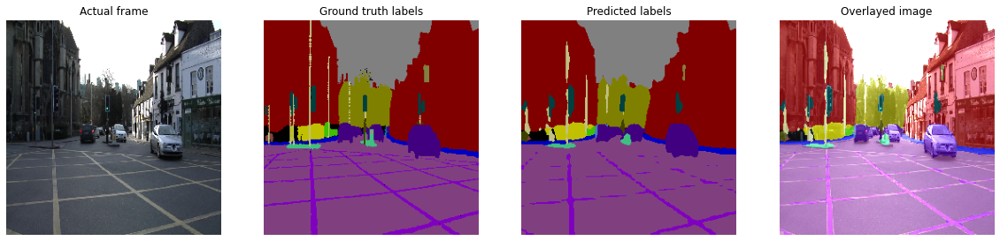

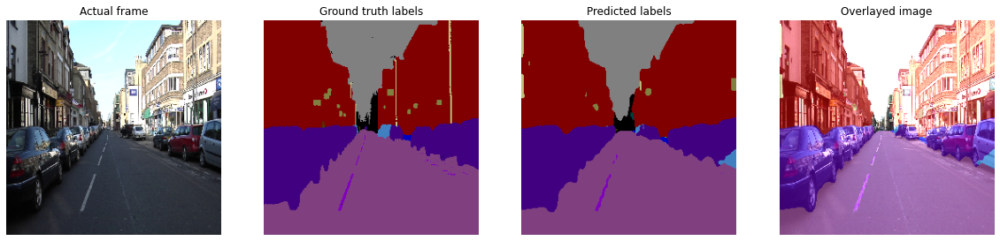

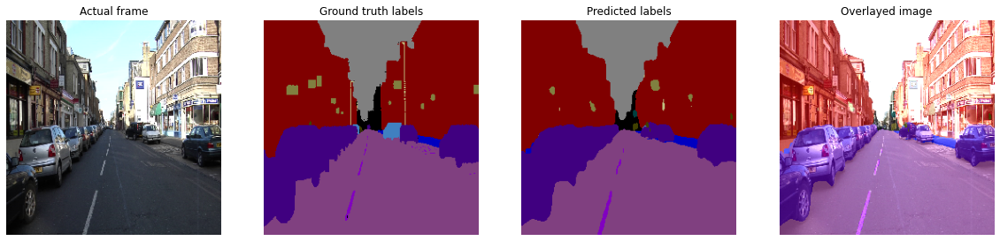

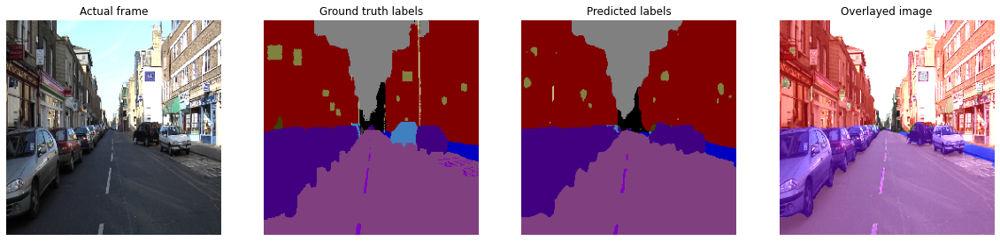

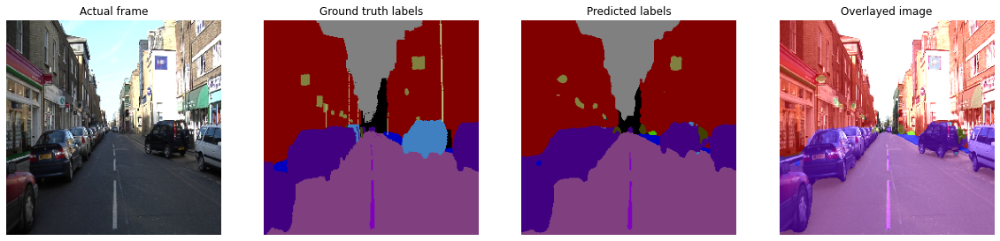

1/1 [==============================] - 0s 30ms/step


In [ ]:
inference(trained_model, valid_ds)

In [ ]:
def dir_inference(image_dir, mask_dir, trained_model, num_images_to_process=3):

    all_images = sorted(glob.glob(f"{image_dir}"))
    all_masks  = sorted(glob.glob(f"{mask_dir}"))

    num_frames_to_skip = 4

    num_images_to_process = min(num_images_to_process, len(all_images)/num_frames_to_skip)

    i = 0
    for k in range(num_images_to_process):

        i = i + num_frames_to_skip

        plt.figure(figsize=(18, 18))

        image = cv2.imread(all_images[i])
        mask  = cv2.imread(all_masks[i])

        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        mask  = cv2.cvtColor(mask, cv2.COLOR_BGR2RGB)

        orig_image = image.copy()
        h, w, _ = orig_image.shape

        image = cv2.resize(image, (DatasetConfig.IMG_WIDTH, DatasetConfig.IMG_HEIGHT))
        image = tf.convert_to_tensor(image, dtype=tf.float32)
        image = tf.expand_dims(image, axis=0)

        outputs = trained_model.predict(image)

        outputs = tf.squeeze(outputs, axis=0)
        outputs = np.array(outputs, dtype=np.float32)
        outputs_resized = cv2.resize(outputs, (w, h))
        rgb_outputs_resized = num_to_rgb(outputs_resized.argmax(-1), color_map=id2color)
        overlayed_image = image_overlay(orig_image, np.array((rgb_outputs_resized * 255).astype('uint8')))

        plot_data = [orig_image, mask, rgb_outputs_resized]
        plt.imshow(overlayed_image)
        plt.axis('off')
        plt.show()

        plt.figure(figsize=(16, 8))

        for j in range(3):
            plt.subplot(1, 3, j+1)
            plt.imshow(plot_data[j])
            plt.axis('off')
            # Show the high resolution overlayed image only.
        plt.tight_layout()
        plt.show()

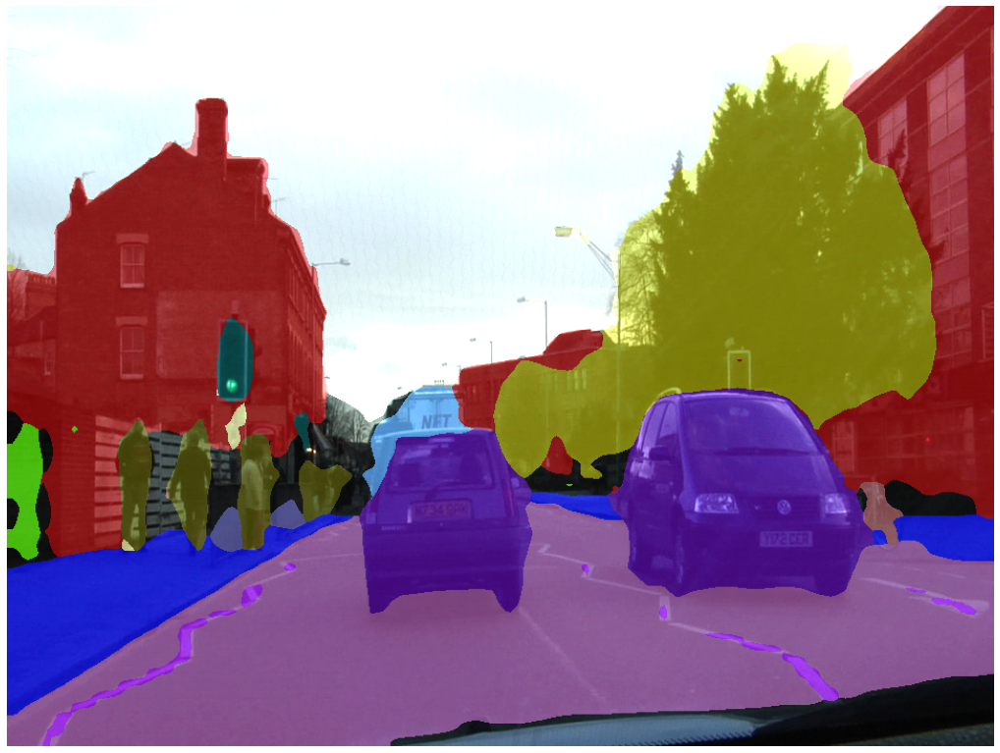

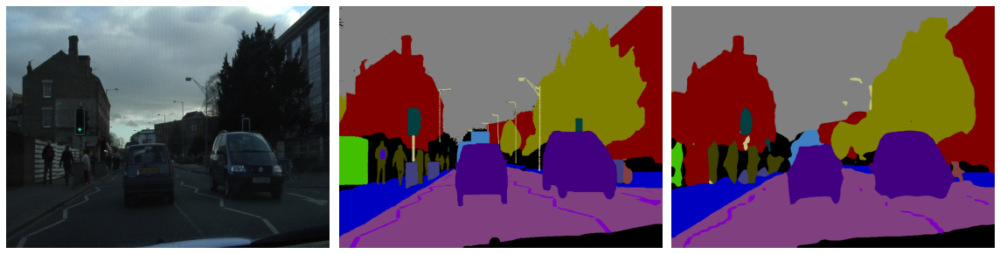

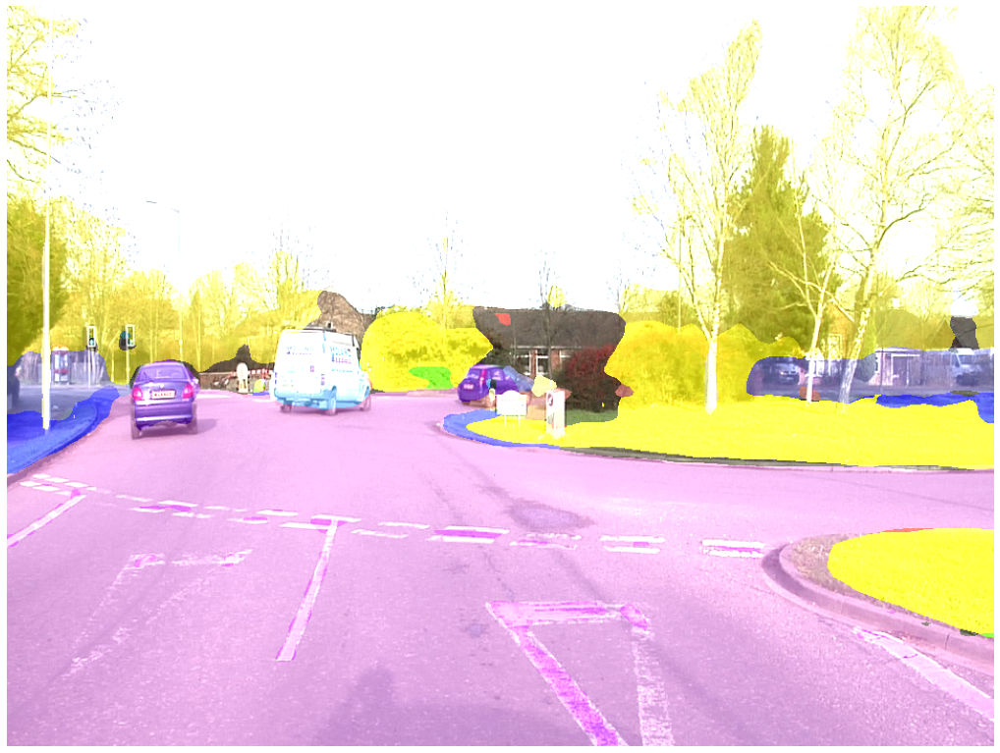

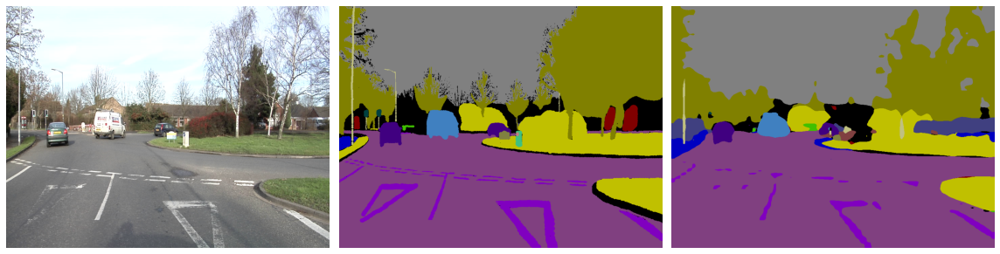

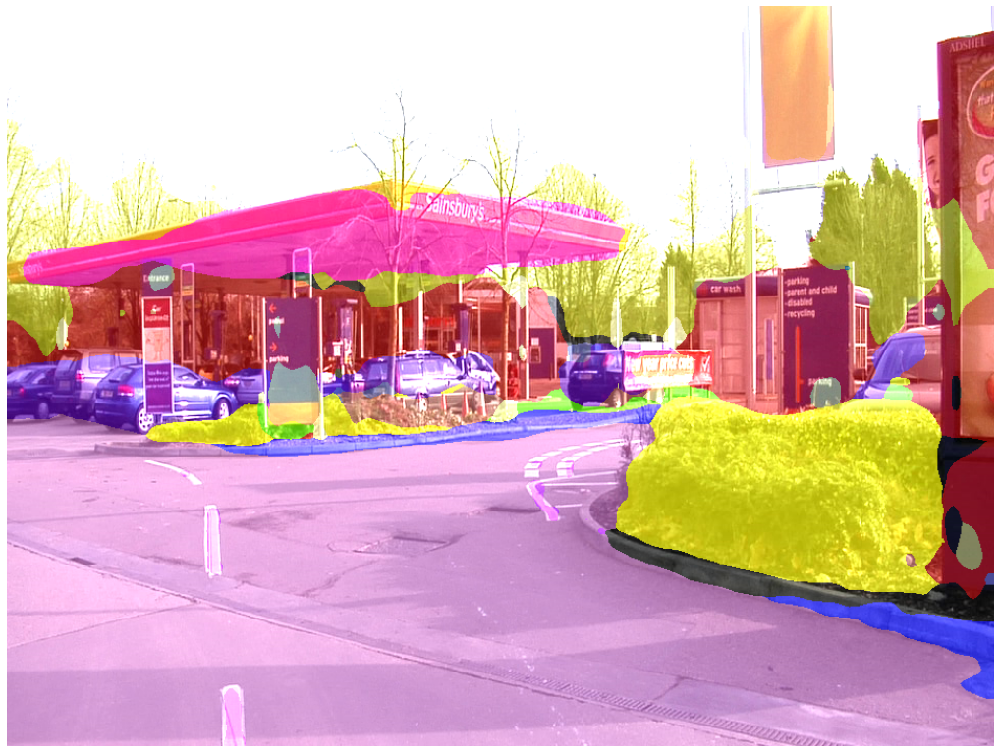

...

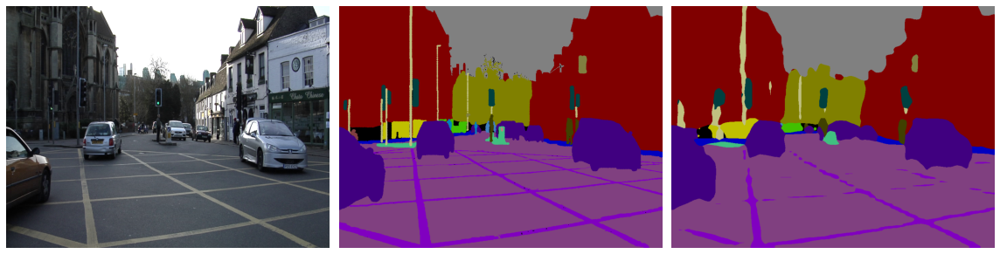

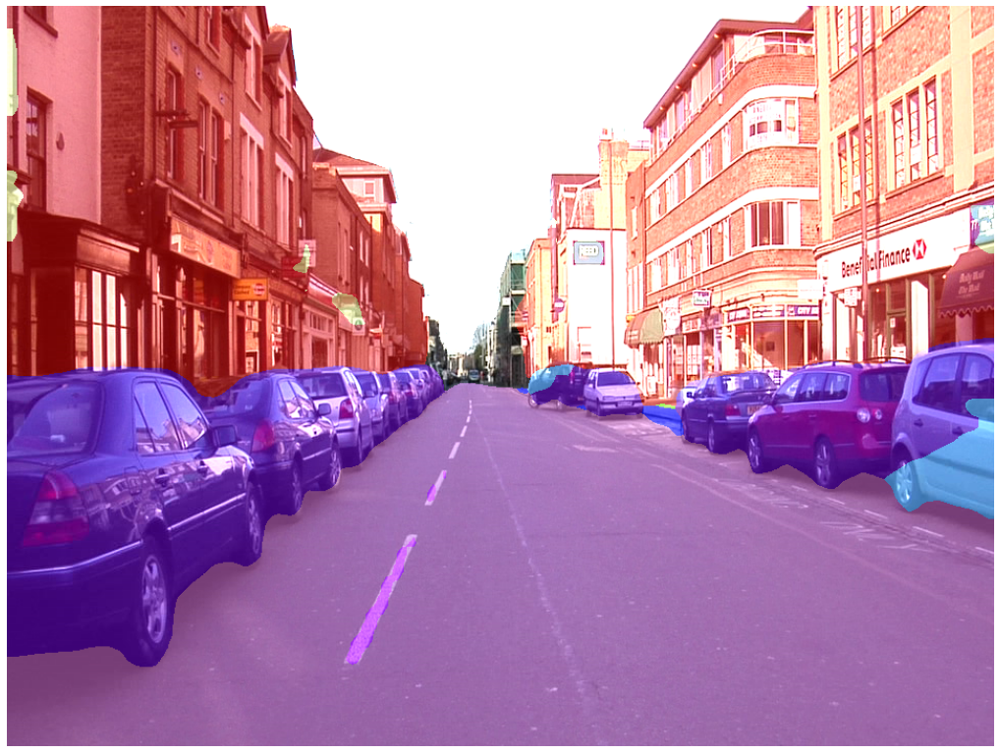

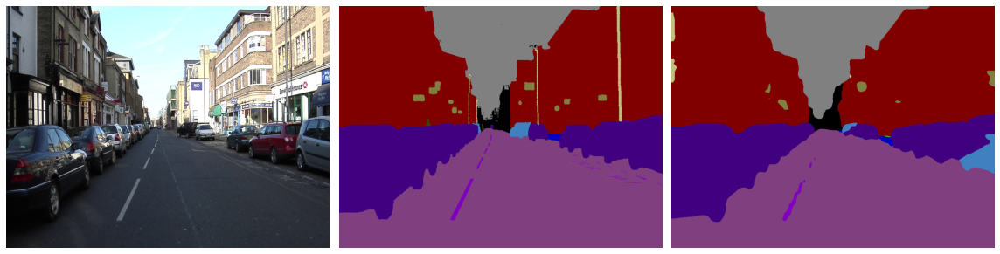

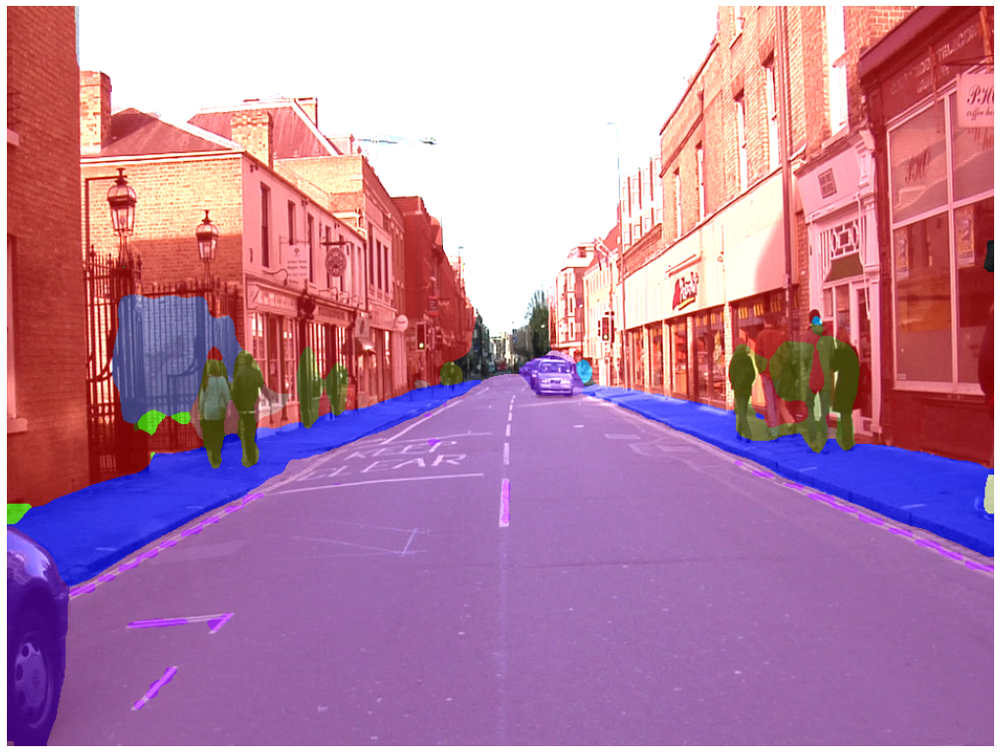

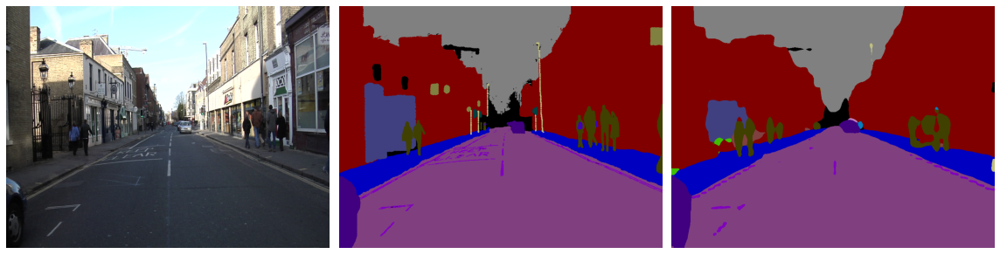

In [ ]:
dir_inference(DatasetConfig.DATA_VALID_IMAGES,
              DatasetConfig.DATA_VALID_LABELS,
              trained_model,
              num_images_to_process=12,
             )